# **Advanced Lane Finding**

## **Udacity Self Driving Car Engineer Nanodegree - Project 2**

The goal of this project is to develop a pipeline to process a video stream from a forward-facing camera mounted on the front of a car, and output an annotated video which identifies:

* The positions of the lane lines
* The location of the vehicle relative to the center of the lane
* The radius of curvature of the road

This can be done using advanced computer vision and colorspace exploration. The important steps of the project include -

* Compute the camera calibration matrix and distortion coefficients given a set of chessboard images.
* Apply a distortion correction to raw images.
* Use color transforms, gradients, etc., to create a thresholded binary image.
* Apply a perspective transform to rectify binary image ("birds-eye view").
* Detect lane pixels and fit to find the lane boundary.
* Determine the curvature of the lane and vehicle position with respect to center.
* Warp the detected lane boundaries back onto the original image.
* Output visual display of the lane boundaries and numerical estimation of lane curvature and vehicle position.

Let's import some of the important libraries first. List of libraries to eb imported are - matplotlib, numpy, pickle, glob, opencv, and os

In [2]:
#importing some useful packages
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import pickle
import glob
import cv2
%matplotlib inline

## Reading Image for Visualization

Let's read an image to see what we are dealing with.

This image is: <class 'numpy.ndarray'> with dimensions: (720, 1280, 3)


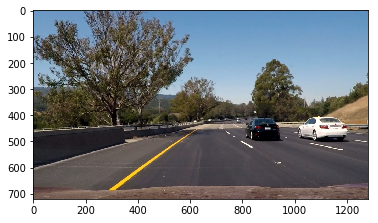

In [3]:
#reading in an image
image = mpimg.imread('test_images_old/test6.jpg')

#printing out some stats and plotting
print('This image is:', type(image), 'with dimensions:', image.shape)
plt.imshow(image)  # if you wanted to show a single color channel image called 'gray', for example, call as plt.imshow(gray, cmap='gray')

## Import os

os helps reading and writing a file from and to a folder respectively.

In [4]:
import os
test_img_files = os.listdir('test_images_/')
test_img_files

['straight_lines2-Copy1.jpg',
 'test1-Copy1.jpg',
 'test5-Copy1.jpg',
 'test3-Copy1.jpg',
 'test4-Copy1.jpg',
 'test6-Copy1.jpg',
 'straight_lines1-Copy1.jpg',
 'test2-Copy1.jpg']

In [5]:
#for saving frames from video feeds
# Not a part of video processing 
video_input1 = VideoFileClip('harder_challenge_video.mp4')
imgpath = os.path.join('test_images/', '{}.jpg'.format(45))
video_input1.save_frame(imgpath, 45)

NameError: name 'VideoFileClip' is not defined

## Camera calibration and Image Undistortion

The first step in the project is to remove any distortion from the images by calculating the camera calibration matrix and distortion coefficients using a series of images of a chessboard.

### Camera Calibration using chessboard images

In [6]:
def calibration_point():
    # prepare object points, like (0,0,0), (1,0,0), (2,0,0) ....,(6,5,0)
    objp = np.zeros((6*9,3), np.float32)
    objp[:,:2] = np.mgrid[0:9,0:6].T.reshape(-1,2)
    #criteria for termination
    criteria = (cv2.TERM_CRITERIA_EPS + cv2.TERM_CRITERIA_MAX_ITER, 30, 0.001)
    # Arrays to store object points and image points from all the images.
    objpoints = [] # 3d points in real world space
    imgpoints = [] # 2d points in image plane.

    # Make a list of calibration images
    images = glob.glob('./camera_cal/calibration*.jpg')

    # Step through the list and search for chessboard corners
    for i, fname in enumerate(images):
        img = cv2.imread(fname)
        gray = cv2.cvtColor(img,cv2.COLOR_RGB2GRAY)
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (9,6),None)

        # If found, add object points, image points
        if ret == True:
            objpoints.append(objp)
            # this step to refine image points was taken from:
            # http://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_calib3d/py_calibration/py_calibration.html
            corners2 = cv2.cornerSubPix(gray,corners,(11,11),(-1,-1),criteria)
            imgpoints.append(corners2)
            # Draw the corners
            img = cv2.drawChessboardCorners(img, (9,6), corners, ret)

    return objpoints, imgpoints 

### Image undistortion using image points and object points obtained 

Since opencv function calibrateCamera only works on grayscale images, so first convert the image to grayscale and use it to calculate undistortion matrix for conversion. Using this matrix we can undistort any colorspace image.

In [7]:
def undistort_image(objpoints, imgpoints , img):
    #convert to gray
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Use cv2.calibrateCamera() and cv2.undistort()
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    undist = cv2.undistort(img, mtx, dist, None, mtx)
    return undist


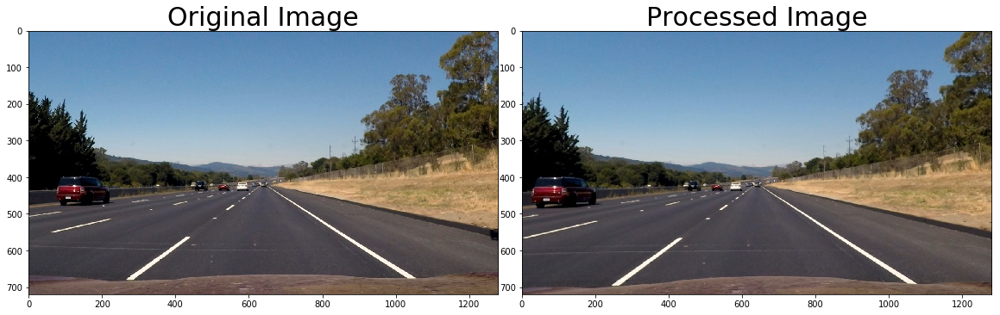

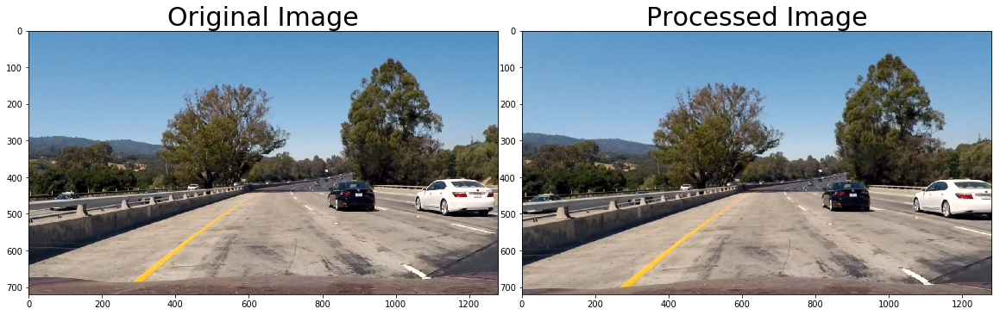

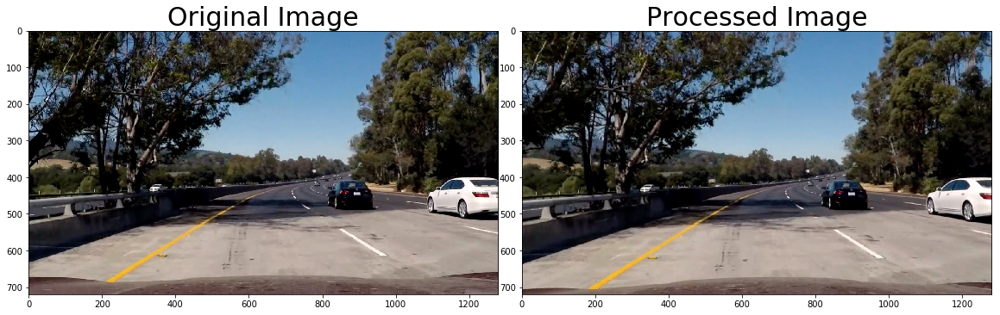

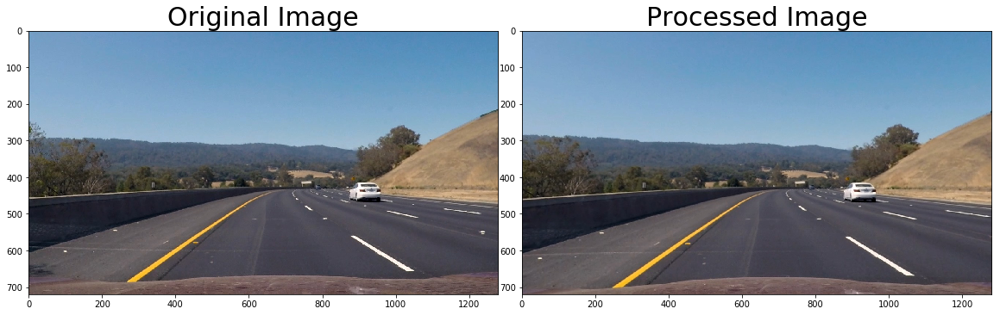

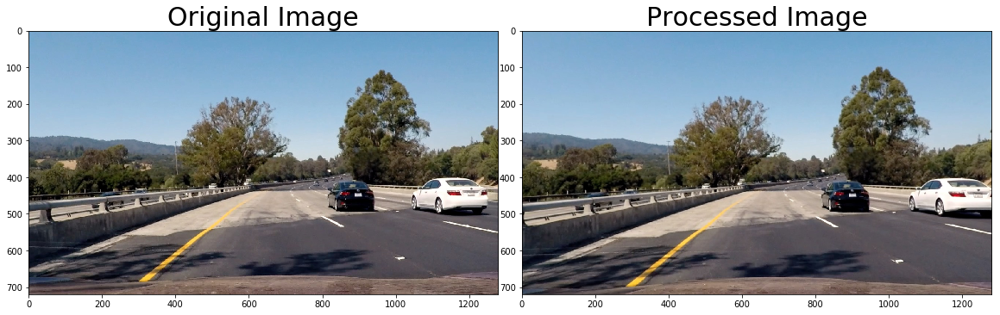

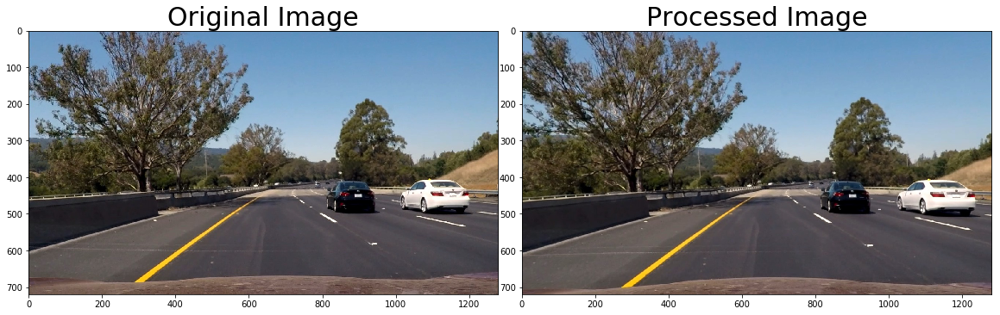

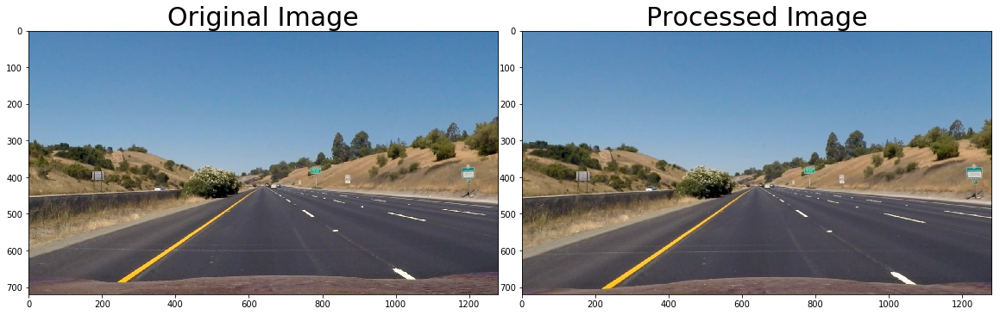

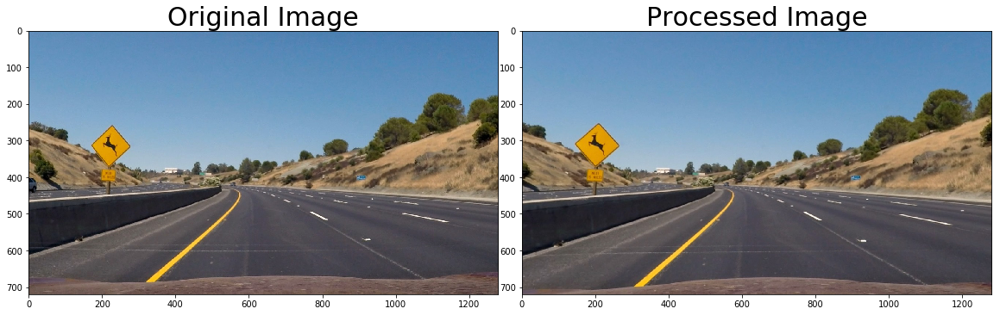

In [8]:
# Try the undistortion on test_images
objpoints , imgpoints = calibration_point()

def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    return undistorted_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)


## Keypoint detection

Keypoint detection using opencv SIFT helps in calculating the points og contrast and color differences i.e corners in an image. I tried using keypoint detection to identify the top and bottom of lane lines and then use them to warp the image perspective. 

However, this increases the computation of the pipeline and with ambiguous goals. We can use the hyperparameters for warping the image and it does a good task. 

However, on a road with very steep elevation the hyperparameter fitting might fail to gve good results, so this can be a good substitute way to find the points required for perspective transform.

In [9]:
def keypoint_detection(whiten):
    sift = cv2.xfeatures2d.SIFT_create()
    kp = sift.detect(whiten,None)
    img=np.zeros_like(whiten)
    img = cv2.drawKeypoints(whiten,kp,img)
    return img

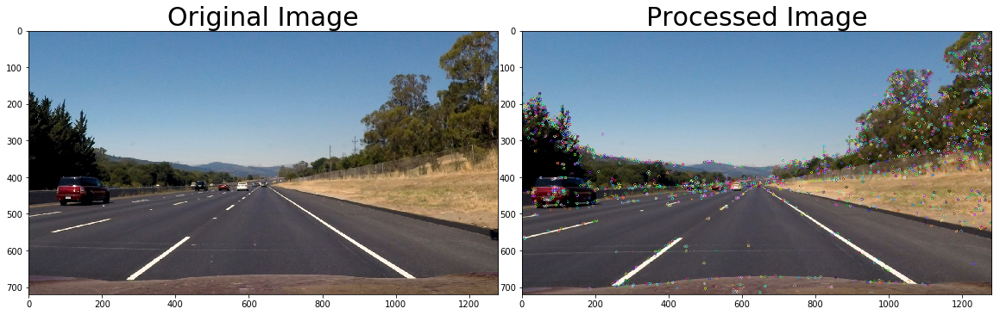

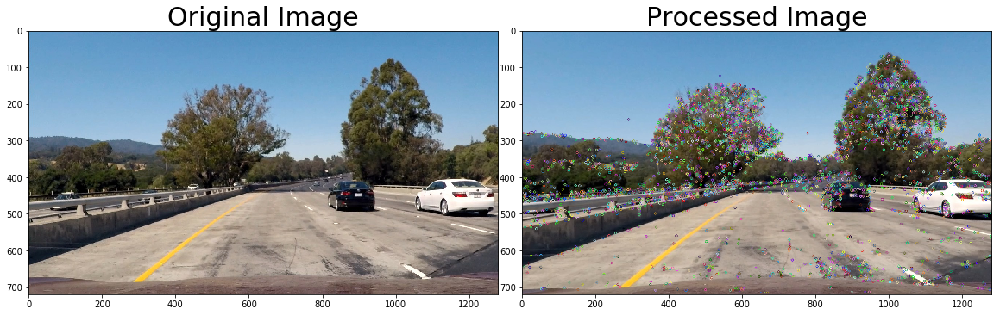

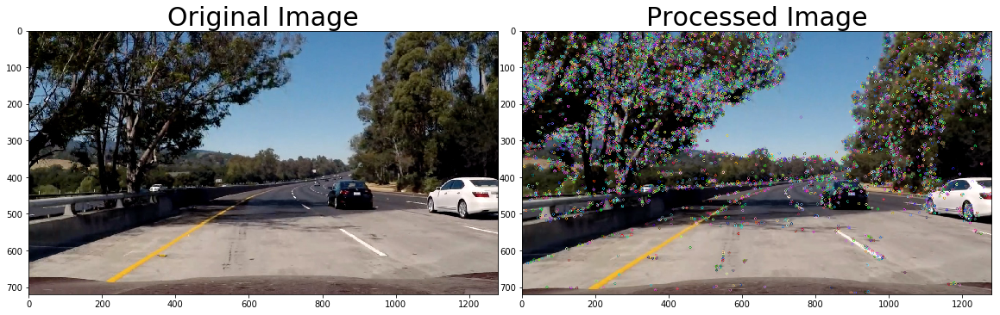

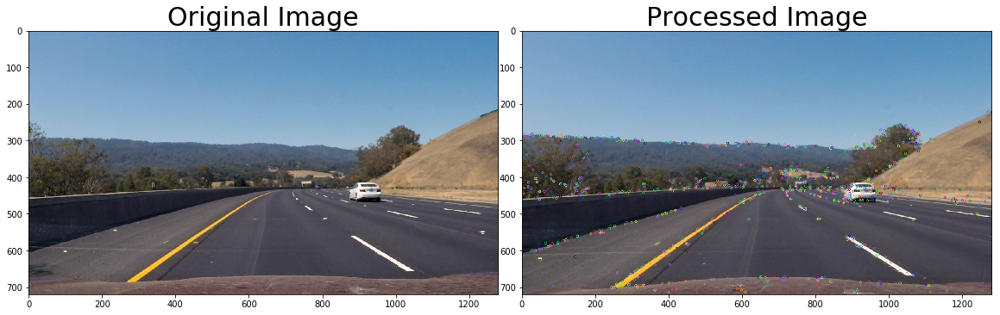

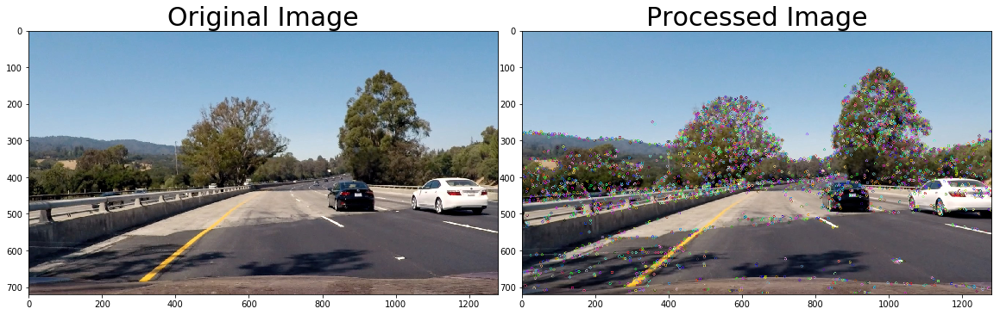

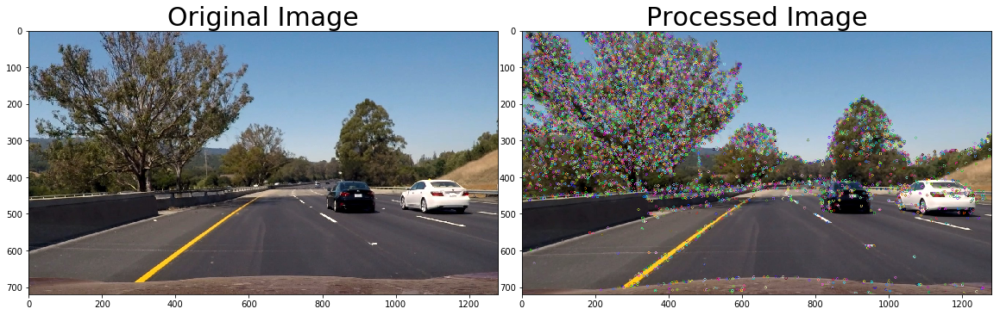

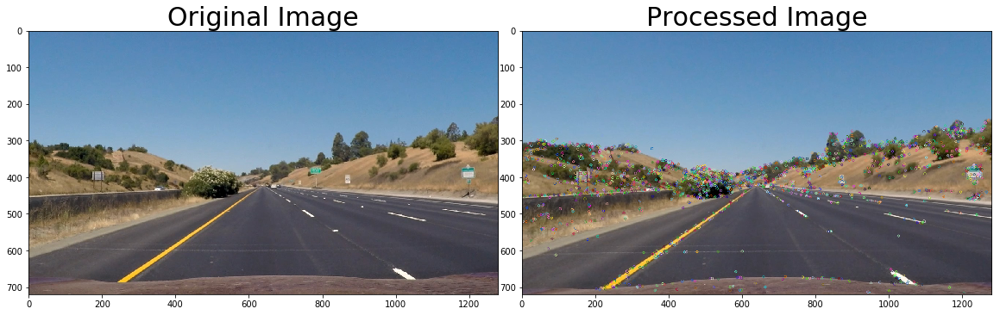

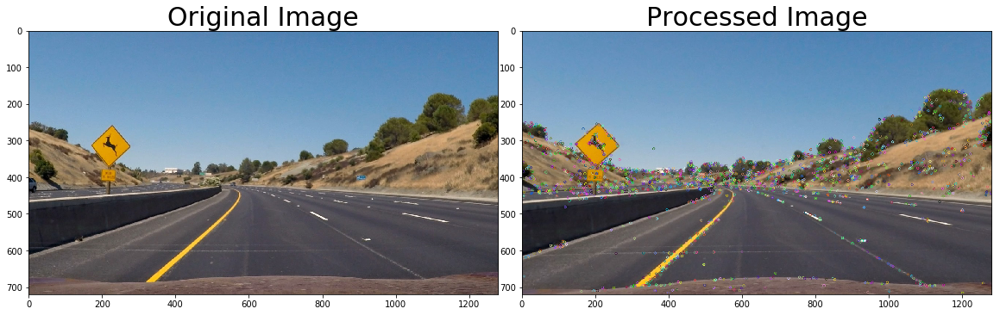

In [10]:
#test of keypoint identification on preprocessed images of test_images set
objpoints , imgpoints = calibration_point()


def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    keypoint_img = keypoint_detection(undistorted_img)
    return keypoint_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)


## Perspective transform

Perspective transform is used to change the perspective or viewpoint of an image. OpenCV provides fuctions for this purpose.

Here we want to change the image perspective from front view to a bird's eye view so that the features of lane line can be read easily.

In [11]:
def perspective_transformer(img):
    #assume values of source and destination for image transform
    h,w = img.shape[:2]
    #HYPERPARAMETERS
    # define source and destination points for transform
    src = np.float32([(575,464),
                      (707,464), 
                      (258,682), 
                      (1049,682)])
    dst = np.float32([(450,0),
                      (w-450,0),
                      (450,h),
                      (w-450,h)])
    # use cv2.getPerspectiveTransform() to get M, the transform matrix, and Minv, the inverse
    M = cv2.getPerspectiveTransform(src, dst)
    Minv = cv2.getPerspectiveTransform(dst, src)
    # use cv2.warpPerspective() to warp your image to a top-down view
    warped = cv2.warpPerspective(img, M, (w,h), flags=cv2.INTER_LINEAR)
    return warped, M, Minv

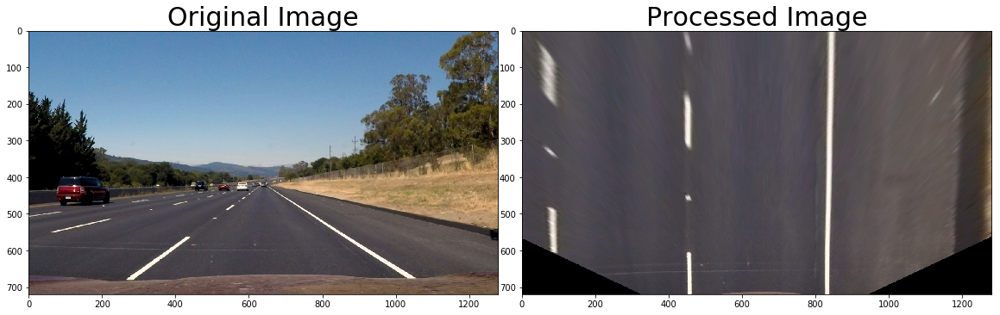

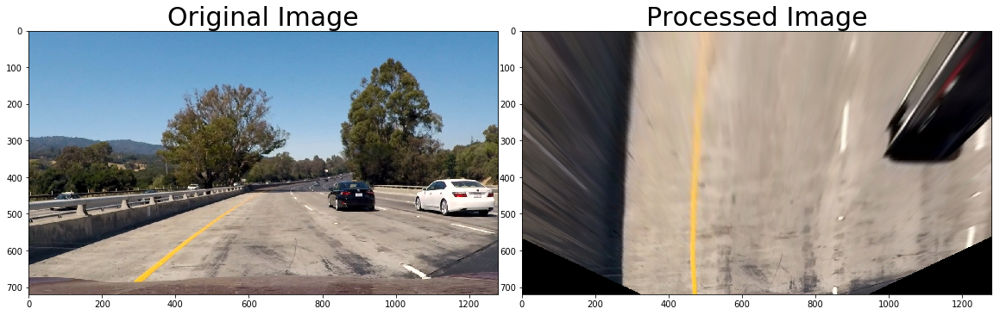

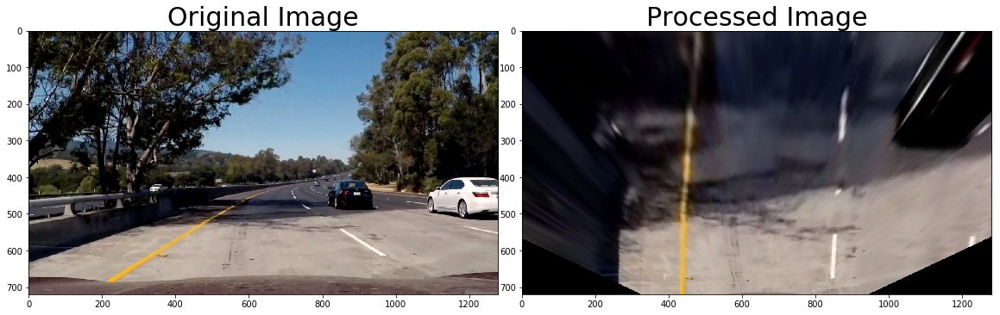

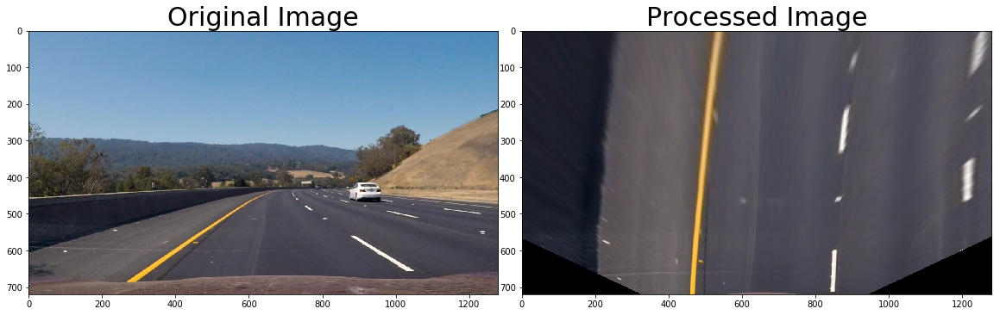

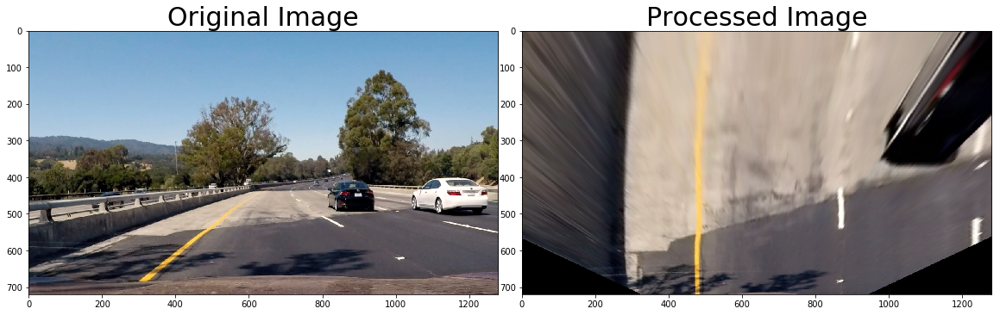

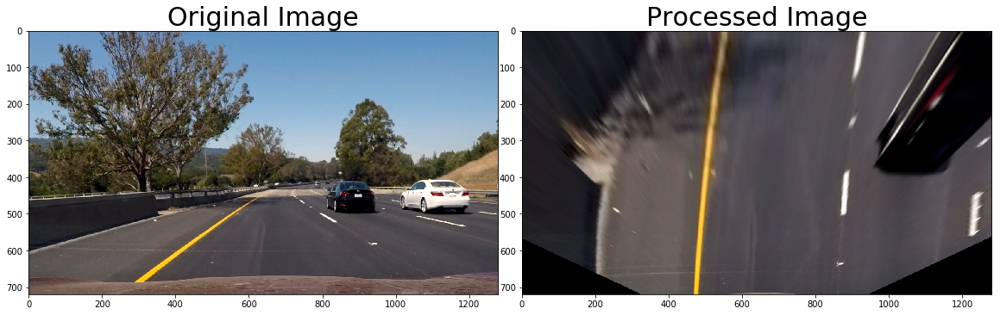

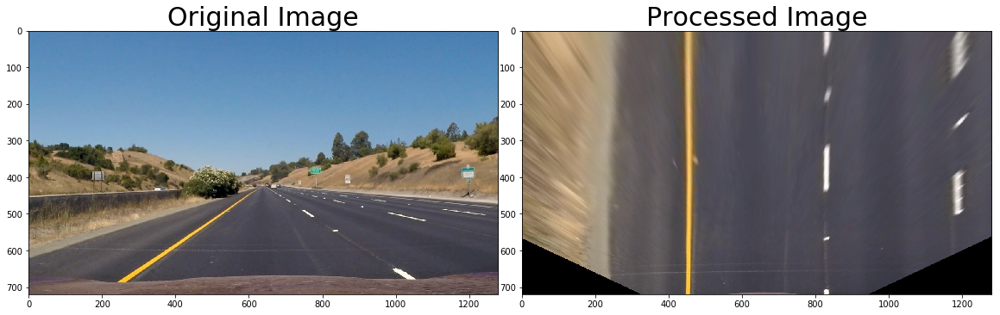

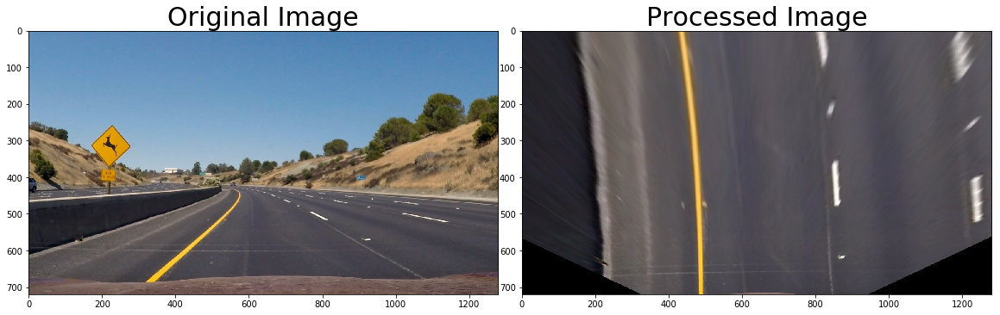

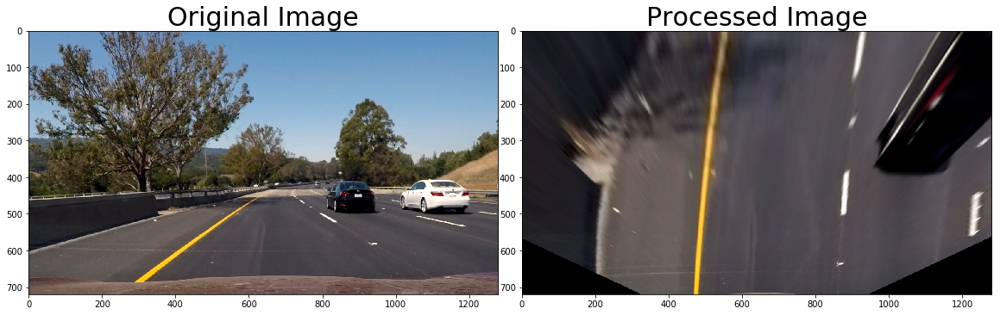

In [12]:
#try perspective transform on test_images
objpoints , imgpoints = calibration_point()

def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    return warped_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)


## Color masking and scale conversion

This step is implemented to remove all the noise from an image using different color channels and color thresholds and just keep the relevant information intact in the image (in this case the lane lines). Following steps were taken :

### RGB to HLS Conversion

RGB to HLS conversion of an image helped in the previous project on lane finding, so tried it. Does not give good results on light condition variances in this project. However, L-channel of HLS colorspace within the range [220,255] reads white lines precisely with varying light conditions.

### RGB to LAB Conversion

LAB is another such color space with the B-channel within the range [190,255] detects white lines precisely. 

### Other conversions

HSV, YCrCb colorspces were also tested for image masking. Best fit was obtained using the above 2 channels.

Results after white and yellow color masking using HLS-L and LAB-B channels is visualized.


In [13]:
#USELESS. NEVERMIND! Tested on thse and dinot want to throw them away
# image is expected be in RGB color space
#changing image to hls colorspace
def rgb_hls_converter2(img):
    return cv2.cvtColor(img,cv2.COLOR_RGB2HLS)
    
def rgb_hsv_converter2(img):
    img = cv2.cvtColor(img,cv2.COLOR_RGB2HSV)
    #HYPERPARAMETERS
    # white color mask
    lower = np.uint8([0, 200, 0])
    upper = np.uint8([255, 255, 255])
    white_mask = cv2.inRange(img, lower, upper)
    # yellow color mask
    lower = np.uint8([20, 190, 20])
    upper = np.uint8([30, 255, 255])
    yellow_mask = cv2.inRange(img, lower, upper)
    # combine the mask
    mask = cv2.bitwise_or(white_mask, yellow_mask)
    masked = cv2.bitwise_and(img, img, mask = mask)
    return yellow_mask
    
def rgb_lab_converter2(img):
    img = cv2.cvtColor(img,cv2.COLOR_RGB2LAB)
    #HYPERPARAMETERS
    # white color mask
    lower = np.uint8([0, 200, 0])
    upper = np.uint8([255, 255, 255])
    white_mask = cv2.inRange(img, lower, upper)
    # yellow color mask
    lower = np.uint8([20, 110, 170])
    upper = np.uint8([255, 140, 215])
    yellow_mask = cv2.inRange(img, lower, upper)
    # combine the mask
    mask = cv2.bitwise_or(white_mask, yellow_mask)
    masked = cv2.bitwise_and(img, img, mask = mask)
    return yellow_mask

def rgb_YCrCb_converter2(img):
    img = cv2.cvtColor(img,cv2.COLOR_RGB2YCrCb)
    #HYPERPARAMETERS
    # white color mask
    lower = np.uint8([0, 200, 0])
    upper = np.uint8([255, 255, 255])
    white_mask = cv2.inRange(img, lower, upper)
    # yellow color mask
    lower = np.uint8([20, 142,   20])
    upper = np.uint8([255, 163, 90])
    yellow_mask = cv2.inRange(img, lower, upper)
    # combine the mask
    mask = cv2.bitwise_or(white_mask, yellow_mask)
    masked = cv2.bitwise_and(img, img, mask = mask)
    return yellow_mask

# changing the image to identify white and yellow color items by applying mask 
def rgb_to_white_yellow_converter(img):
    #HYPERPARAMETERS
    # white color mask
    lower = np.uint8([0, 200, 0])
    upper = np.uint8([255, 255, 255])
    white_mask = cv2.inRange(img, lower, upper)
    # yellow color mask
    lower = np.uint8([10, 0,   100])
    upper = np.uint8([40, 255, 255])
    yellow_mask = cv2.inRange(img, lower, upper)
    # combine the mask
    mask = cv2.bitwise_or(white_mask, yellow_mask)
    masked = cv2.bitwise_and(img, img, mask = mask)
    return masked

In [14]:
#THIS WORKS!!!
def rgb_hls_converter(img, thresh=(220, 255)):
    # 1) Convert to HLS color space
    hls = cv2.cvtColor(img, cv2.COLOR_RGB2HLS)
    hls_l = hls[:,:,1]
    hls_l = hls_l*(255/np.max(hls_l))
    # 2) Apply a threshold to the L channel
    binary_output = np.zeros_like(hls_l)
    binary_output[(hls_l > thresh[0]) & (hls_l <= thresh[1])] = 1
    # 3) Return a binary image of threshold result
    return binary_output

In [15]:
#THIS WORKS!!!
def rgb_lab_converter(img, thresh=(190,255)):
    # 1) Convert to LAB color space
    lab = cv2.cvtColor(img, cv2.COLOR_RGB2Lab)
    lab_b = lab[:,:,2]
    # don't normalize if there are no yellows in the image
    if np.max(lab_b) > 175:
        lab_b = lab_b*(255/np.max(lab_b))
    # 2) Apply a threshold to the L channel
    binary_output = np.zeros_like(lab_b)
    binary_output[((lab_b > thresh[0]) & (lab_b <= thresh[1]))] = 1
    # 3) Return a binary image of threshold result
    return binary_output

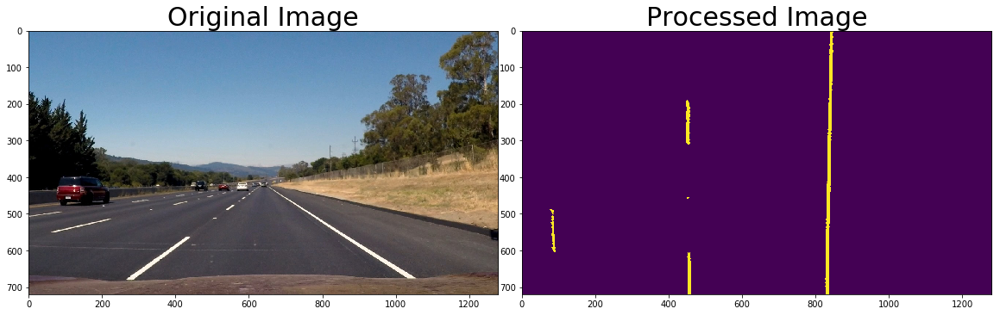

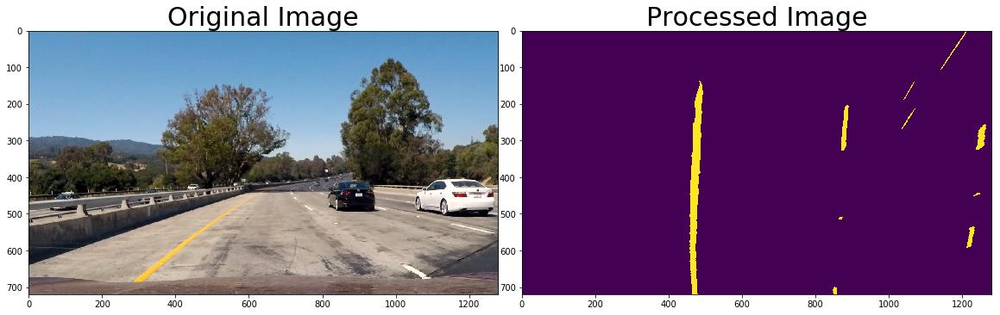

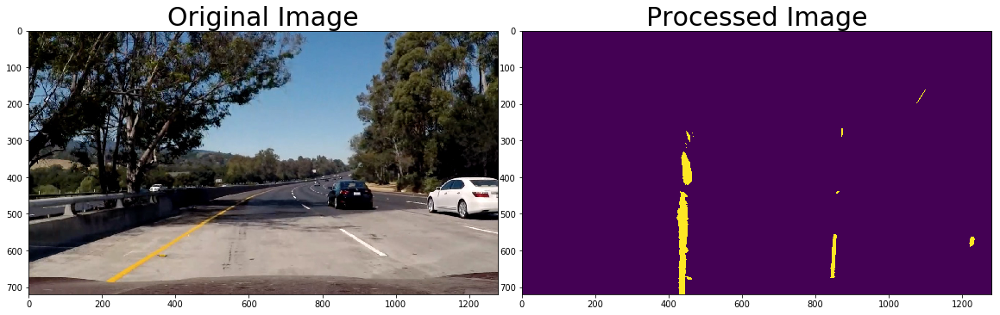

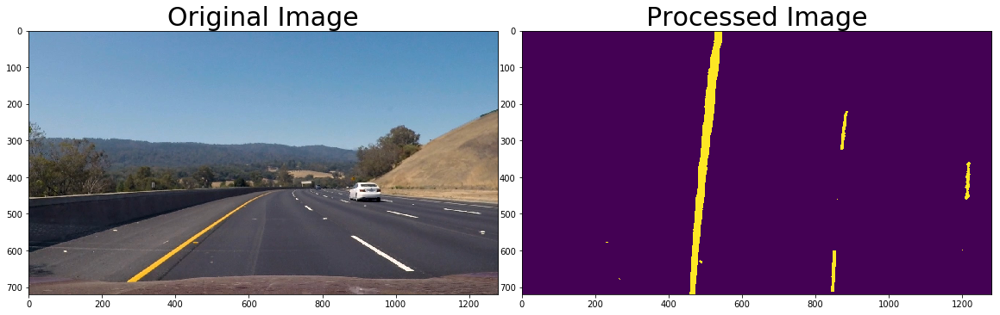

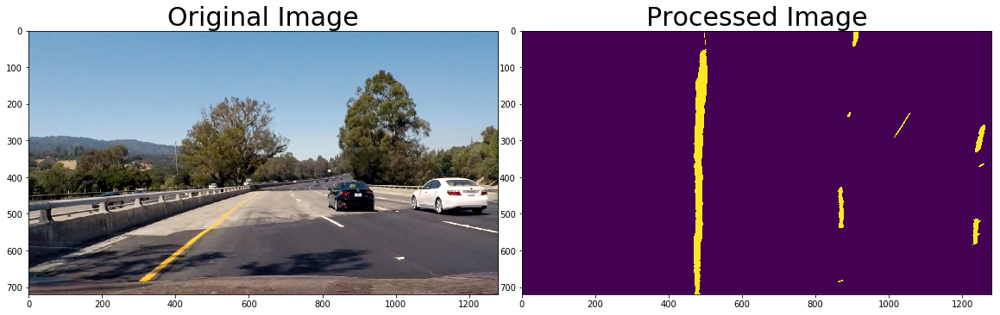

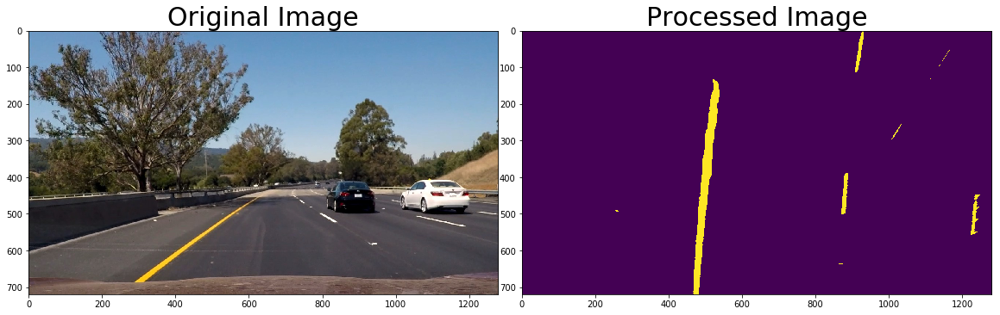

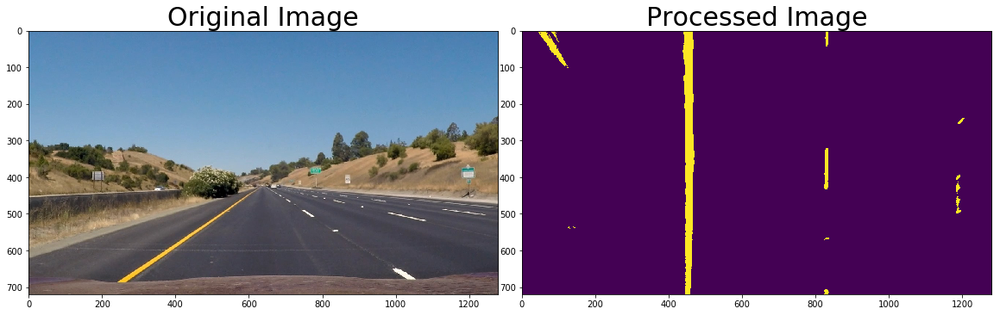

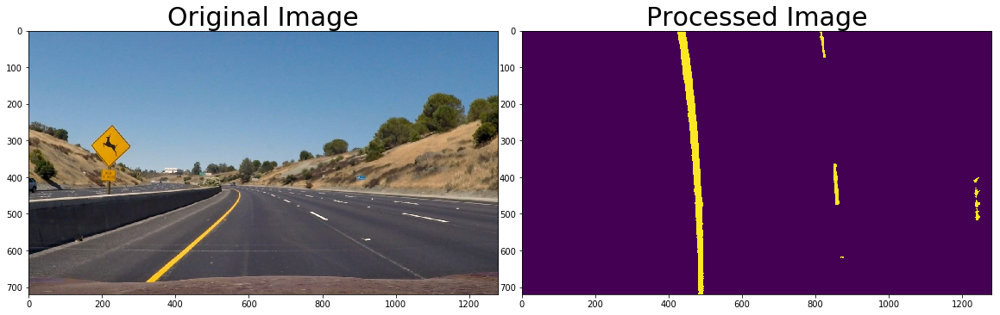

In [27]:
#testing hls conversions on transformed image of test_images set 
objpoints , imgpoints = calibration_point()

def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    #hls_img2 = rgb_hls_converter2(warped_img)
    #hsv_img = rgb_hsv_converter2(warped_img)
    #lab_img2 = rgb_lab_converter2(warped_img)
    #ycrcb = rgb_YCrCb_converter2(warped_img)
    #wy_img = rgb_to_white_yellow_converter(warped_img)
    lab_img = rgb_lab_converter(warped_img)
    hls_img = rgb_hls_converter(warped_img)
    combined_img = np.zeros_like(hls_img)
    combined_img[(lab_img == 1) | (hls_img == 1)] = 1
    return combined_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)


### GrayScale conversion

This conversion is pretty good for gradient calculation and edge detections. But I didnot use it later in my pipeline.

In [28]:
# changing image to grayscale 
def grayscale_converter(img):
    """Applies the Grayscale transform
    This will return an image with only one color channel
    but NOTE: to see the returned image as grayscale
    (assuming your grayscaled image is called 'gray')
    you should call plt.imshow(gray, cmap='gray')"""
    return cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Or use BGR2GRAY if you read an image with cv2.imread()
    # return cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

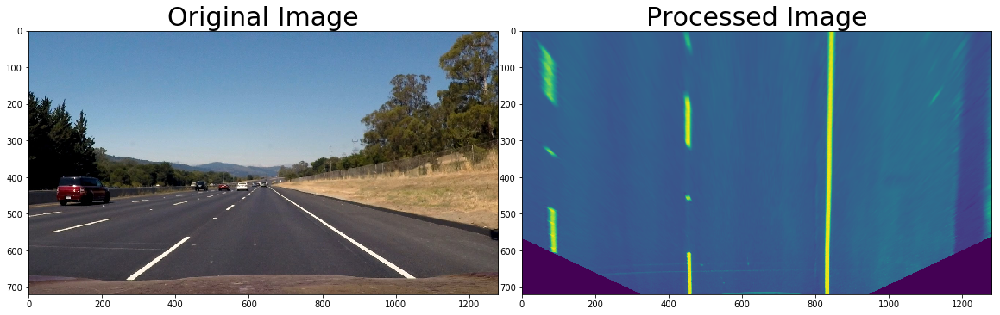

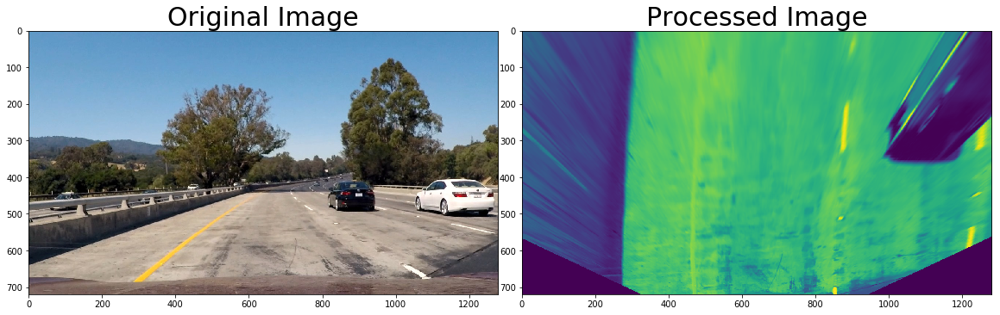

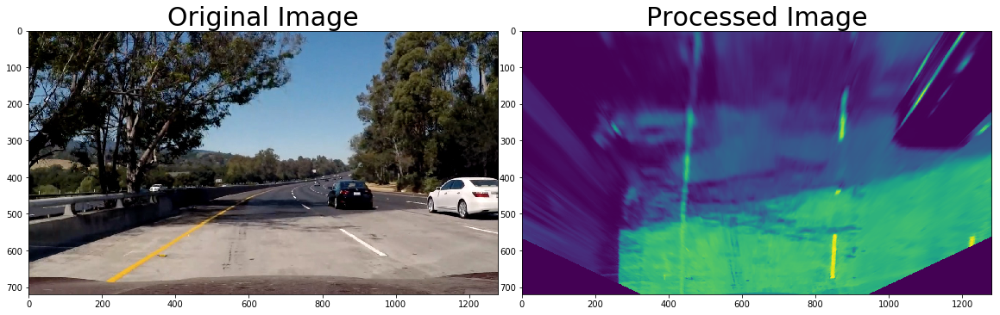

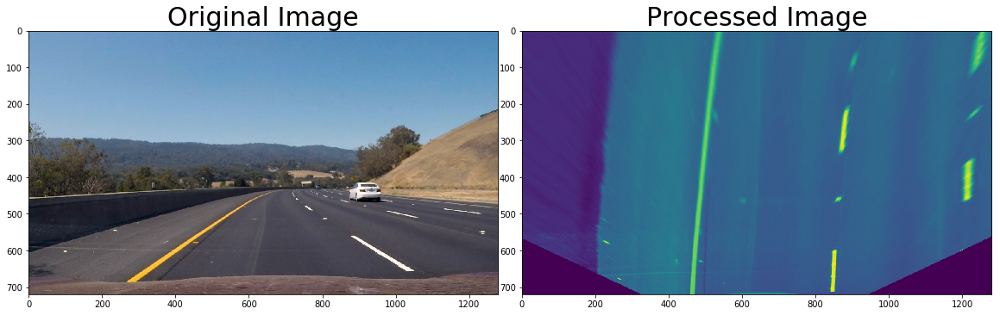

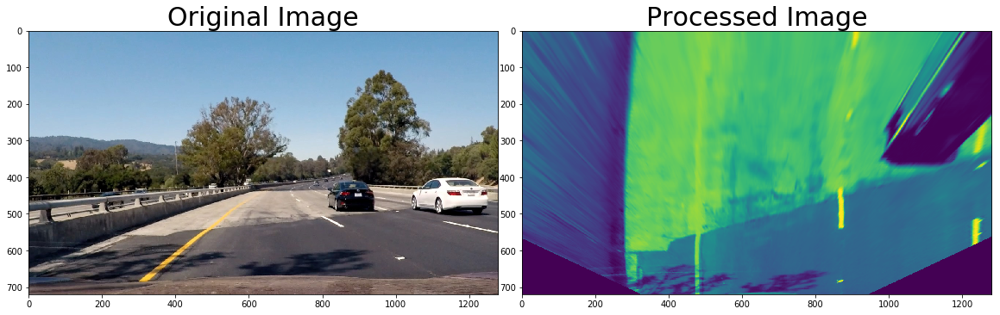

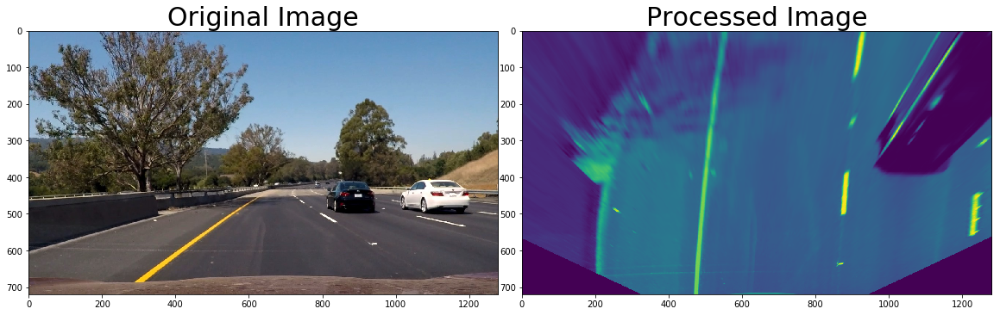

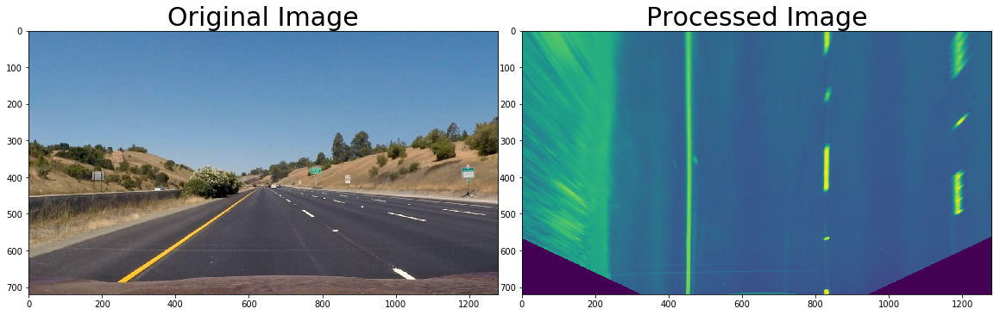

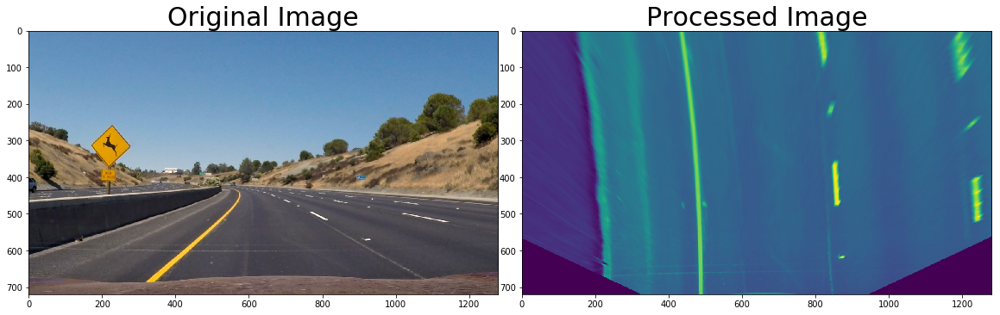

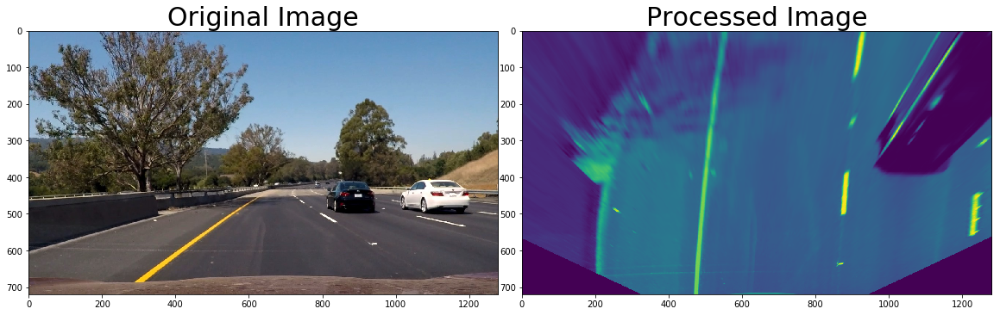

In [29]:
# testing grayscale conversion of preprocessed images from test_images set
objpoints , imgpoints = calibration_point()


def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    gray_img = grayscale_converter(warped_img)
    return gray_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)


## Sobel transformation

Sobel transform of combined_img. Sobel Magnitude threshold and Sobel Gradient threshold were considered to efficiently remove noise. 

In [30]:
#sobel function
#takes sobel transform in x and y and finds the magnitude and direction of change passing a threshold value 
#careful to only pass grayscale images
def sobel_transformer(img, mag_threshold = (20,255) , dir_threshold = (0,0.5), kernel = 7):
    #sobel x and y transforms
    sobelx = cv2.Sobel(img, cv2.CV_64F, 1, 0, ksize= kernel)
    sobely = cv2.Sobel(img, cv2.CV_64F, 0, 1, ksize= kernel)
    # absolute value of transforms
    abs_sobelx = np.absolute(sobelx)
    abs_sobely = np.absolute(sobely)
    # magnitude of transforms
    mag_sobel = np.sqrt(abs_sobelx**2 + abs_sobely**2)
    # direction of transforms
    dir_sobel = np.arctan2(abs_sobely,abs_sobelx)
    #scaling magnitude of sobel transforms
    mag_scaled_sobel = np.uint8(255*mag_sobel/np.max(mag_sobel))
    #thresholding
    #magnitude thresholding
    mag_thres_sobel = np.zeros_like(mag_scaled_sobel)
    mag_thres_sobel[(mag_scaled_sobel >= mag_threshold[0]) & (mag_scaled_sobel < mag_threshold[1])] = 1
    #direction thresholding
    dir_thres_sobel = np.zeros_like(dir_sobel)
    dir_thres_sobel[(dir_sobel >= dir_threshold[0]) & (dir_sobel < dir_threshold[1])] = 1
    #combining 2 thresholdings
    final_sobel = np.zeros_like(img)
    final_sobel[(mag_thres_sobel == 1) & (dir_thres_sobel == 1)] = 1
    
    return final_sobel

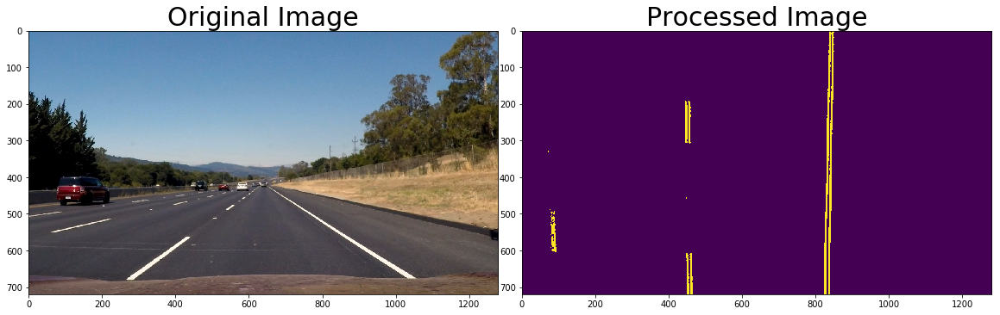

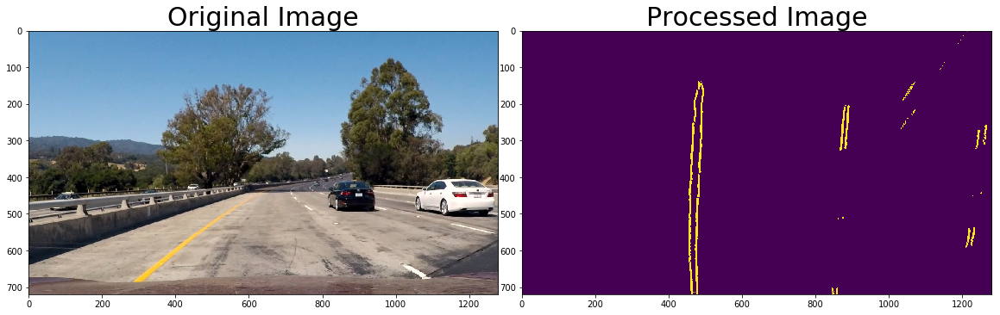

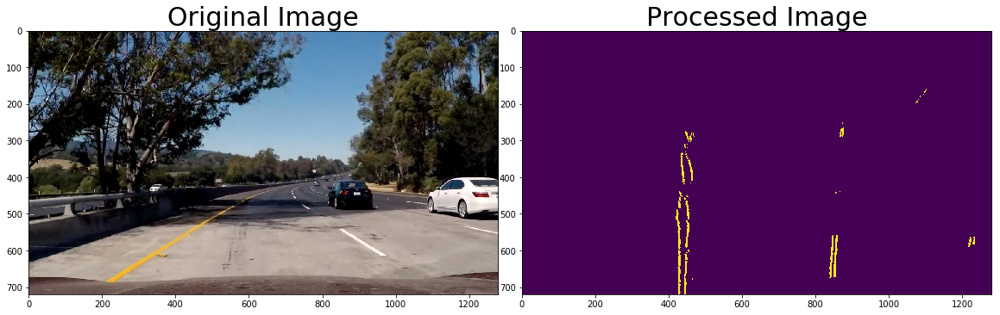

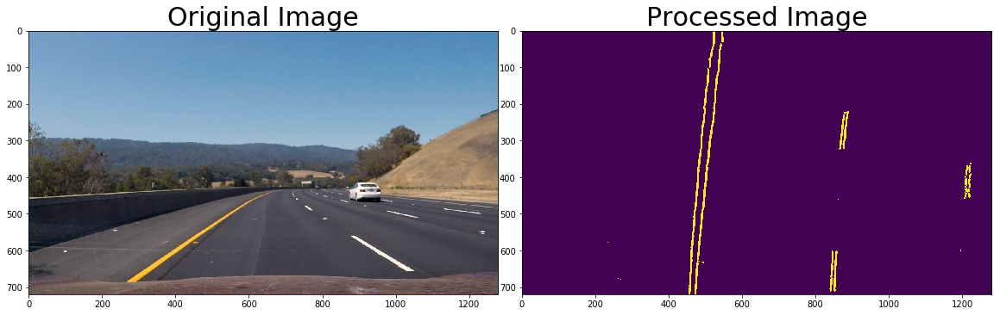

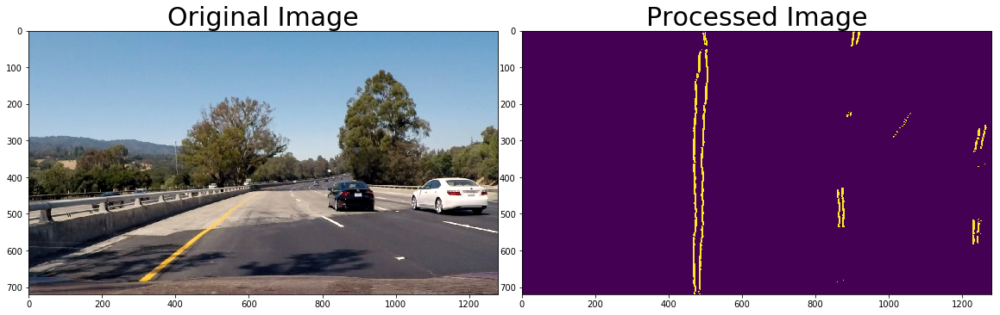

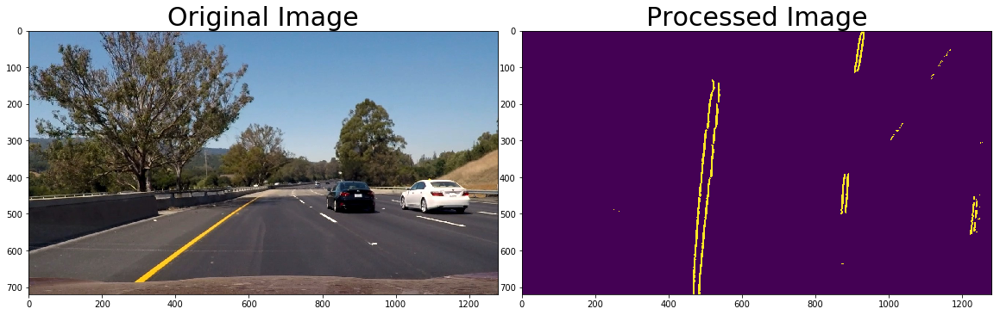

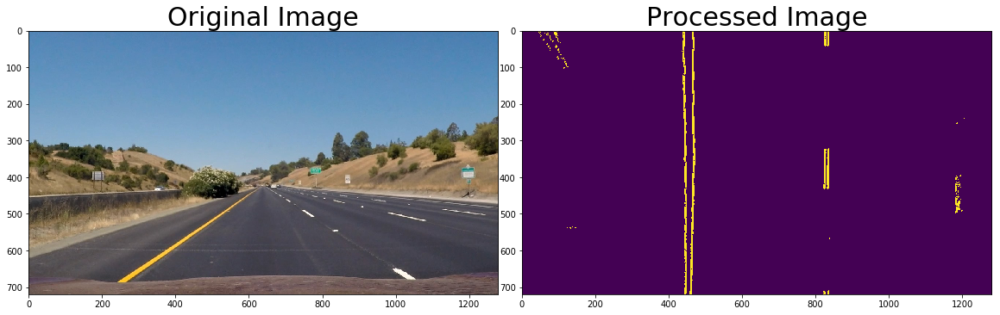

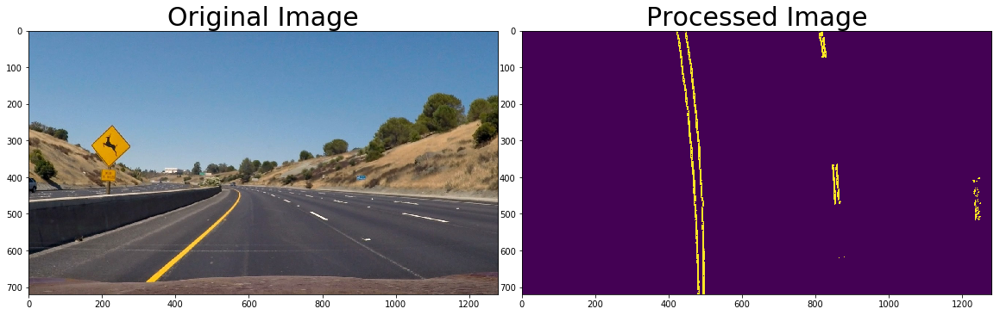

In [32]:
#testing sobel transform on preprocessed images of test_images set
objpoints , imgpoints = calibration_point()

def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    lab_img = rgb_lab_converter(warped_img)
    hls_img = rgb_hls_converter(warped_img)
    combined_img = np.zeros_like(hls_img)
    combined_img[(lab_img == 1) | (hls_img == 1)] = 1
    sobel_img = sobel_transformer(combined_img*(255)) #multiply the image by 255 to increase range from [0,1] to [0,255]
    return sobel_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)


## Sliding window polyfit for Lane find

At this point I was able to use the combined binary image to isolate only the pixels belonging to lane lines. The next step was to fit a polynomial to each lane line, which was done by:

* Identifying peaks in a histogram of the image to determine location of lane lines.
* Identifying all non zero pixels around histogram peaks using the numpy function numpy.nonzero().
* Fitting a polynomial to each lane using the numpy function numpy.polyfit().

This can be done by sliding window polyfit method where you select the non-zero pixel without knowing the previous location of lanes. 


In [40]:
def sliding_window_polynomial_generator(img):
    copy_img = np.copy(img)
    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    # Create an output image to draw on and visualize the result
    out_img = np.dstack((img, img, img))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    #midpoint = np.int(img.shape)
    midpoint = np.int(histogram.shape[0]//2)
    quarterpoint = np.int(midpoint//2)
    #plt.plot(histogram)
    
    #setting base values
    
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 10
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 40

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(img.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        ###Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 

        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ###If you found > minpix pixels, recenter next window ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))

        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))



    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    #Fit a second order polynomial to each using `np.polyfit`
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
  
    # Generate x and y values for plotting
    ploty = np.linspace(0, img.shape[0]-1, img.shape[0] )
    try:
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    except TypeError:
        # Avoids an error if `left` and `right_fit` are still none or incorrect
        print('The function failed to fit a line!')
        left_fitx = ploty
        right_fitx = ploty
    
    ## Visualization ##
    # Colors in the left and right lane regions
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    #cv2.fillPoly(out_img, np.int_([pts]), (0,255, 0))
    cv2.polylines(out_img, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
    cv2.polylines(out_img, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)
    
    return out_img, left_fit, right_fit


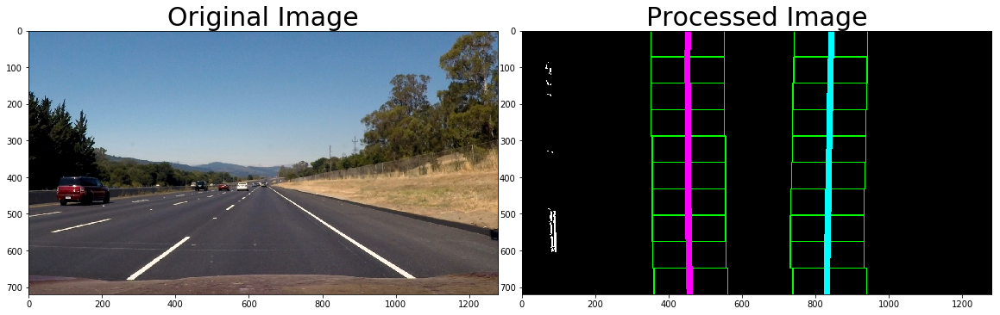

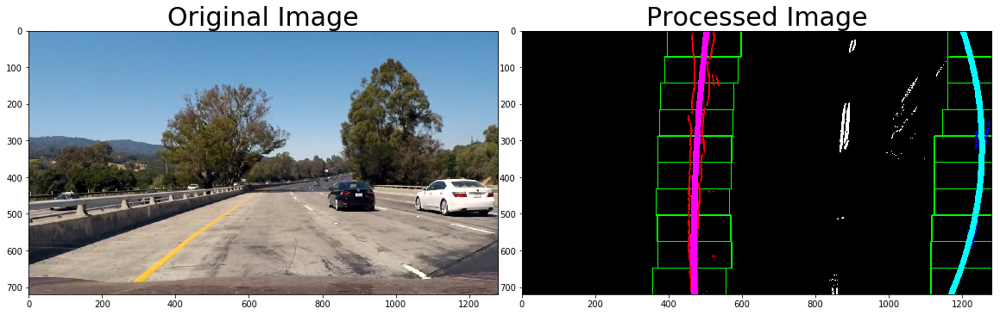

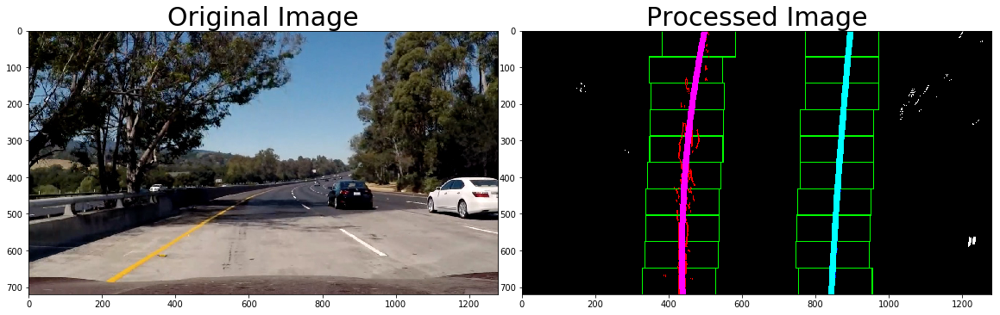

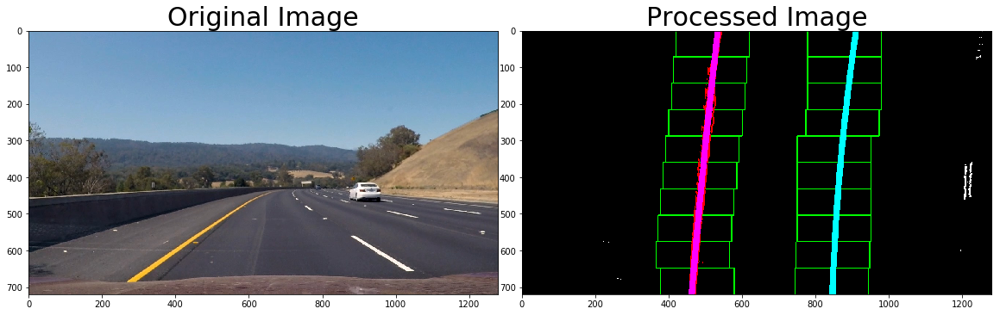

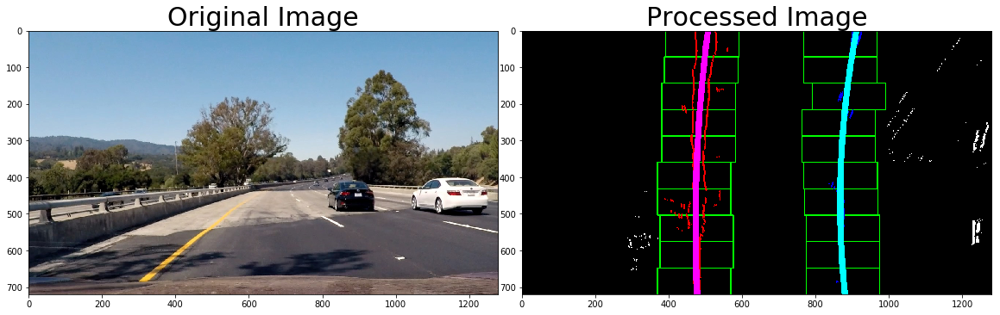

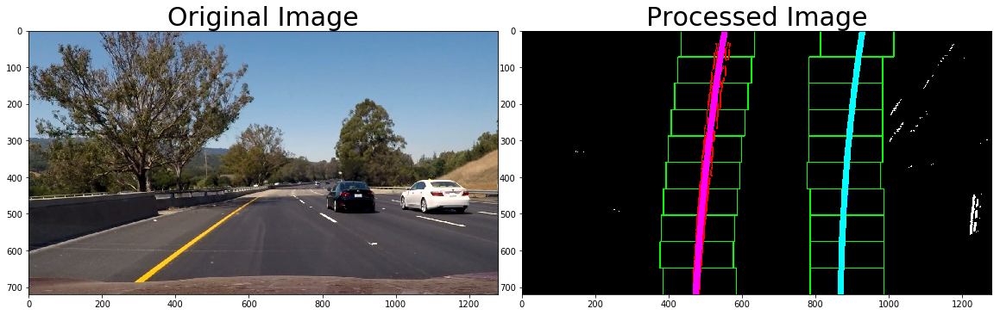

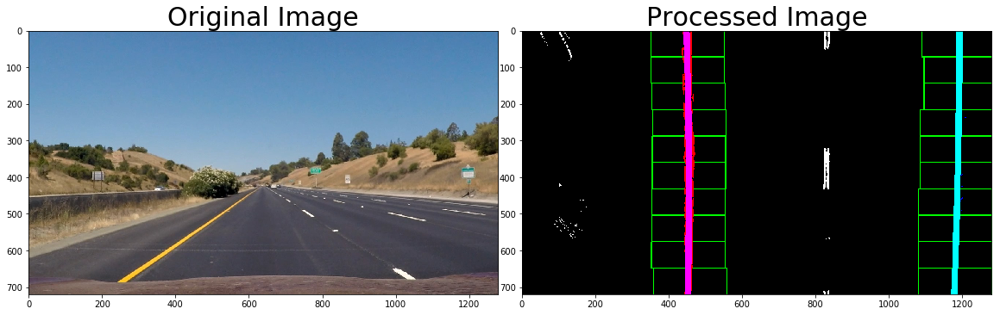

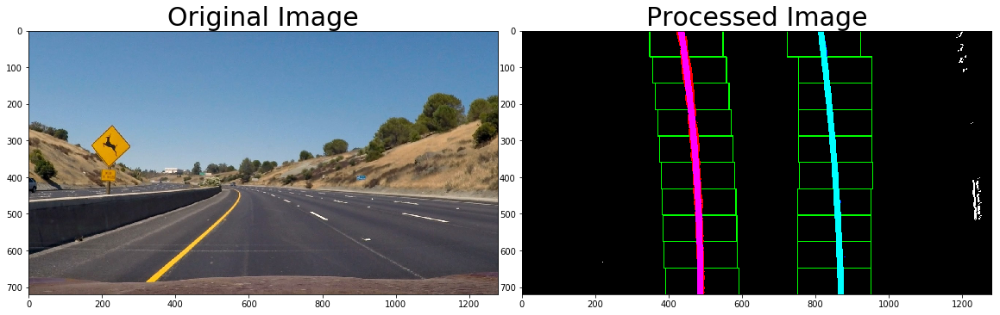

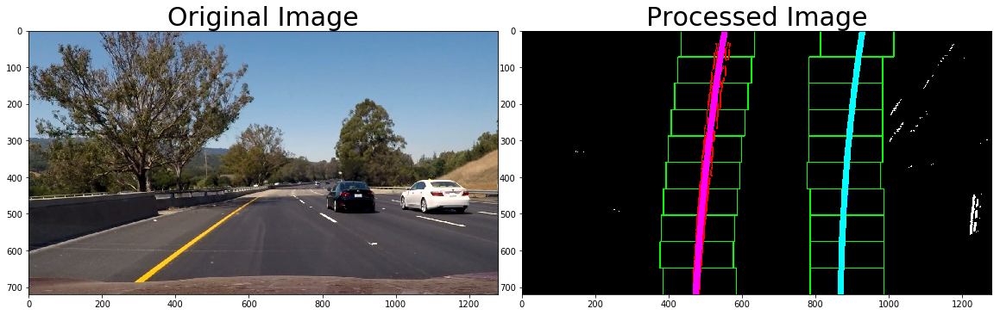

In [41]:
#test on test_images set of preprocessed images
objpoints , imgpoints = calibration_point()

def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    hls_img = rgb_hls_converter(warped_img)
    lab_img = rgb_lab_converter(warped_img)
    combined_img = np.zeros_like(hls_img)
    combined_img[(lab_img == 1) | (hls_img == 1)] = 1
    #wy_img = rgb_to_white_yellow_converter(hls_img)
    #gray_img = grayscale_converter(wy_img)
    sobel_img = sobel_transformer((combined_img)*255)
    #keypoint_detection(whiten_img)
    #whiten_img = np.dstack((sobel_img,sobel_img,sobel_img))*255
    polyfit_img, left_fit, right_fit = sliding_window_polynomial_generator(sobel_img)
    return polyfit_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    #plt.imshow(lane_image)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)
    


## Previous frame usage

If you know the previous loaction of lane lines a search within a given area around those lanes helps in finding lines continuously and computationally faster than rectangular area search.

In [43]:
#search around a previous polynomial in given range margin
def search_around_poly(binary_img, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    margin = 100

    # Grab activated pixels
    nonzero = binary_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### consider the window areas for the similarly named variables ###
    ### but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    ### Fit a second order polynomial to each with np.polyfit() ###
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)

    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_img.shape[0]-1, binary_img.shape[0])
    ###Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    ## Visualization ##
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_img, binary_img, binary_img))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, 
                              ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, 
                              ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return result, left_fit, right_fit

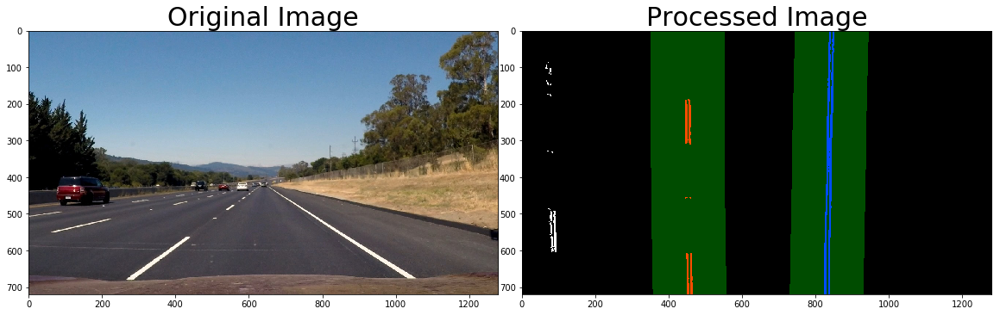

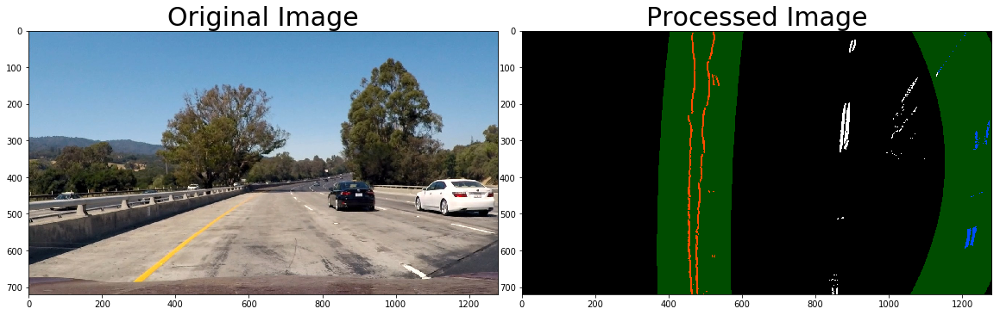

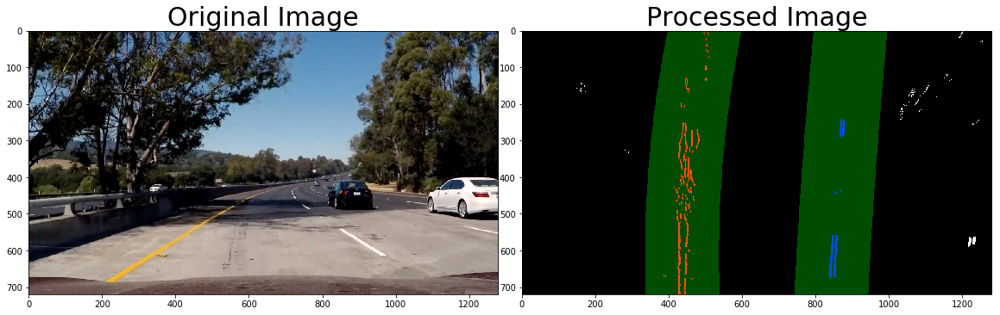

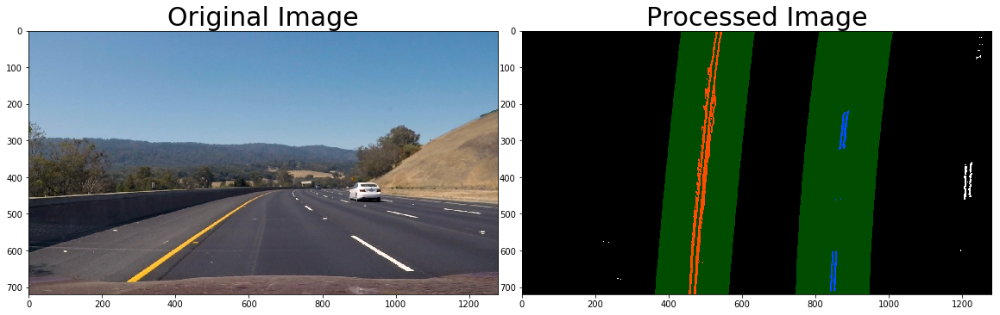

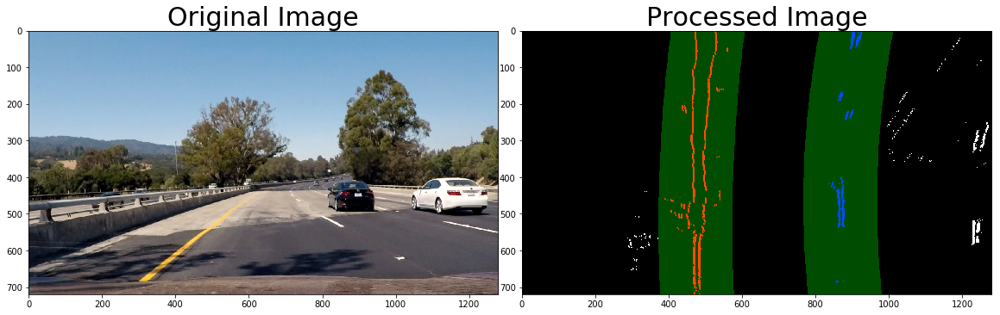

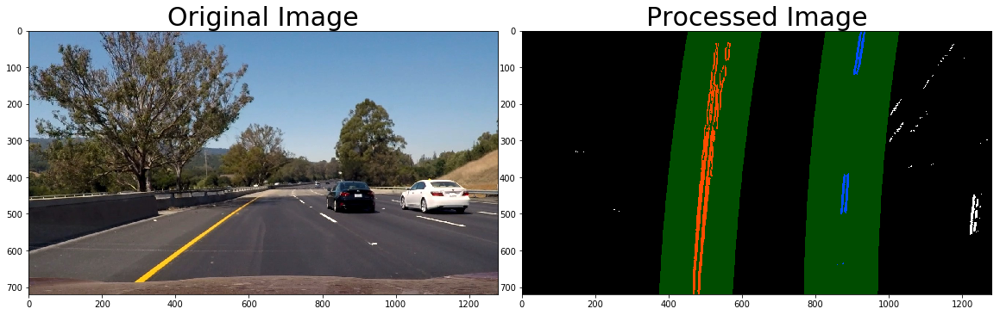

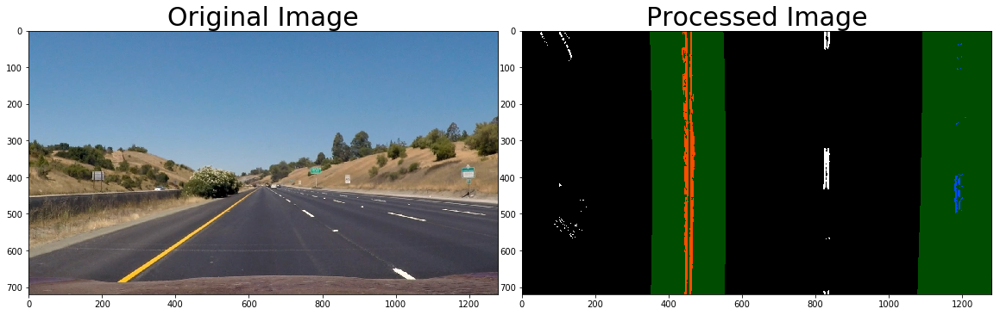

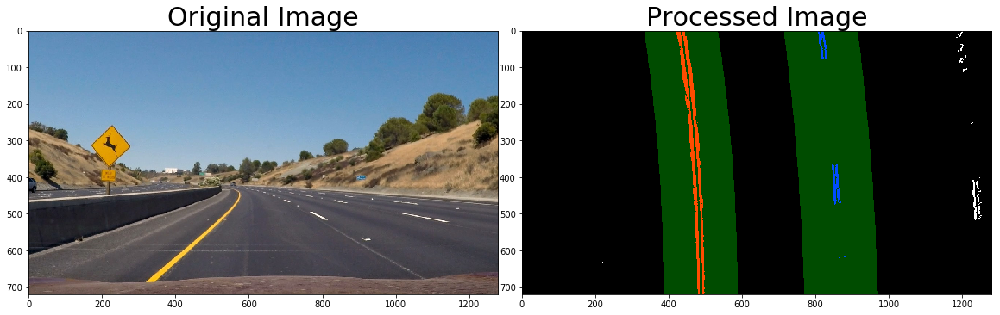

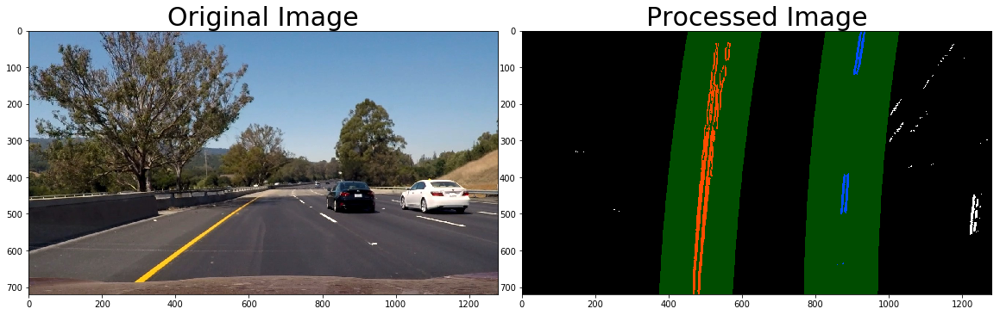

In [48]:
# test previous frame usage algorithm on test_images set
objpoints , imgpoints = calibration_point()

def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    hls_img = rgb_hls_converter(warped_img)
    lab_img = rgb_lab_converter(warped_img)
    combined_img = np.zeros_like(hls_img)
    combined_img[(lab_img == 1) | (hls_img == 1)] = 1
    #wy_img = rgb_to_white_yellow_converter(hls_img)
    #gray_img = grayscale_converter(wy_img)
    sobel_img = sobel_transformer(combine_img*255)
    #keypoint_detection(whiten_img)
    #whiten_img = np.dstack((sobel_img,sobel_img,sobel_img))*255
    polyfit_img, left_fit, right_fit = sliding_window_polynomial_generator(sobel_img)
    poly_img, left_fit, right_fit = search_around_poly(sobel_img, left_fit, right_fit)
    return poly_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)


## Radius of Curvature and Distance from center of Lane calculation

After fitting the polynomials I was able to calculate the position of the vehicle with respect to center with the following calculations:

* Calculated the average of the x intercepts from each of the two polynomials position = (rightx_int+leftx_int)/2
* Calculated the distance from center by taking the absolute value of the vehicle position minus the halfway point along the horizontal axis distance_from_center = abs(image_width/2 - position)
* If the horizontal position of the car was greater than image_width/2 than the car was considered to be left of center, otherwise right of center.
* Finally, the distance from center was converted from pixels to meters by multiplying the number of pixels by 3.7/400 in x-direction and 3.048/100 in y-direction.

Next I used the following code to calculate the radius of curvature and position of car for each lane line in meters:

In [45]:
def radius_central_distance_calculator(img, left_fit, right_fit):
    #conversion factor in x and y direction for warped image to actual lane
    #approximations : do something for exact values
    ym_per_pix = 3.048/100 #since dashed lines according to US regulations is 10feet = 3.048m and its approx 100 pixels on image
    xm_per_pix = 3.7/400 #since lane width is 12feet = 3.7m and its approx 400 pixels on image
    
    # choose the maximum y-value, corresponding to the bottom of the image
    h = img.shape[0]
    ploty = np.linspace(0, h-1, h)
    y_eval = np.max(ploty)
    
    # get left_fitx and right_fitx values
    ###Calc both polynomials using ploty, left_fit and right_fit ###
    left_fitx = left_fit[0]*ploty**2 +left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 +right_fit[1]*ploty + right_fit[2]
    
    #scaling of x and y coordinates to approximate real value
    left_fit_xscaled = list(map(lambda x: x * xm_per_pix, left_fitx))
    right_fit_xscaled = list(map(lambda y: y * xm_per_pix, right_fitx))
    plot_yscaled = list(map(lambda z: z* ym_per_pix, ploty))
    
    #fit a new polynomial to the scaled up dimensions of actual lane
    left_fit_new = np.polyfit(plot_yscaled, left_fit_xscaled, 2)
    right_fit_new = np.polyfit(plot_yscaled, right_fit_xscaled, 2)
    
  
    #RADIUS OF CURVATURE
    # Calculate the new radii of curvature
    left_curverad = ((1 + (2*left_fit_new[0]*y_eval*ym_per_pix + left_fit_new[1])**2)**1.5) / np.absolute(2*left_fit_new[0])
    right_curverad = ((1 + (2*right_fit_new[0]*y_eval*ym_per_pix + right_fit_new[1])**2)**1.5) / np.absolute(2*right_fit_new[0])
    curve_rad = (left_curverad+right_curverad)/2
    # Now our radius of curvature is in meters
        
    #DISTANCE FROM CENTER
    #center of car assumed to be mid way of image
    car_position = (img.shape[1]/2)*xm_per_pix
    left_lane_x = (left_fit_new[0]*(y_eval*ym_per_pix))**2 + (left_fit_new[1]*(y_eval*ym_per_pix)) + left_fit_new[2]
    right_lane_x = (right_fit_new[0]*(y_eval*ym_per_pix))**2 + (right_fit_new[1]*(y_eval*ym_per_pix)) + right_fit_new[2]
    lane_center = (left_lane_x + right_lane_x)/2
    center_dist = (lane_center - car_position)
    #center_dist=0
    
    return curve_rad , center_dist, left_fitx, right_fitx

## Inverting Perspective and marking Lanes on original image

It's better to mark the lanes on the warped image and create a mask of lmarked up lane, and then change the perspective of the mask using perspective transform inverse matrix and add it to the original image.


In [46]:
def original_image_lane_marker(original_img, binary_img, left_fit, right_fit, Minv):
    new_img = np.copy(original_img)
    if left_fit is None or right_fit is None:
        return original_img
    else:
        # Create an image to draw the lines on
        warp_zero = np.zeros_like(binary_img).astype(np.uint8)
        color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

        h,w = binary_img.shape
        ploty = np.linspace(0, h-1, num=h)# to cover same y-range as image
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

        # Recast the x and y points into usable format for cv2.fillPoly()
        pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
        pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
        pts = np.hstack((pts_left, pts_right))

        # Draw the lane onto the warped blank image
        cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))
        cv2.polylines(color_warp, np.int32([pts_left]), isClosed=False, color=(255,0,255), thickness=15)
        cv2.polylines(color_warp, np.int32([pts_right]), isClosed=False, color=(0,255,255), thickness=15)

        # Warp the blank back to original image space using inverse perspective matrix (Minv)
        newwarp = cv2.warpPerspective(color_warp, Minv, (w, h)) 
        # Combine the result with the original image
        result = cv2.addWeighted(new_img, 1, newwarp, 0.5, 0)
    return result

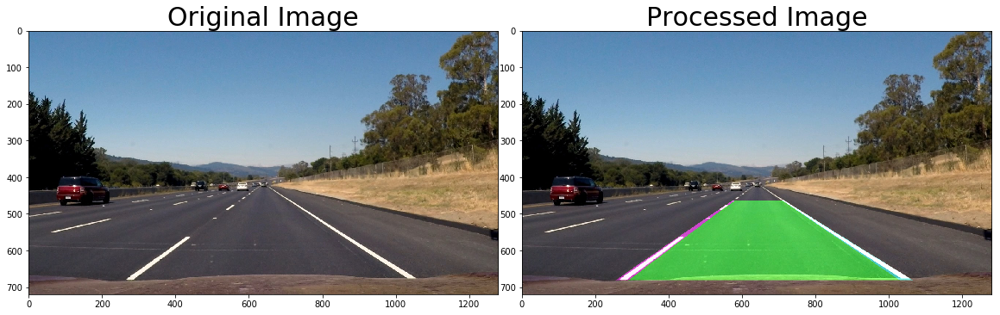

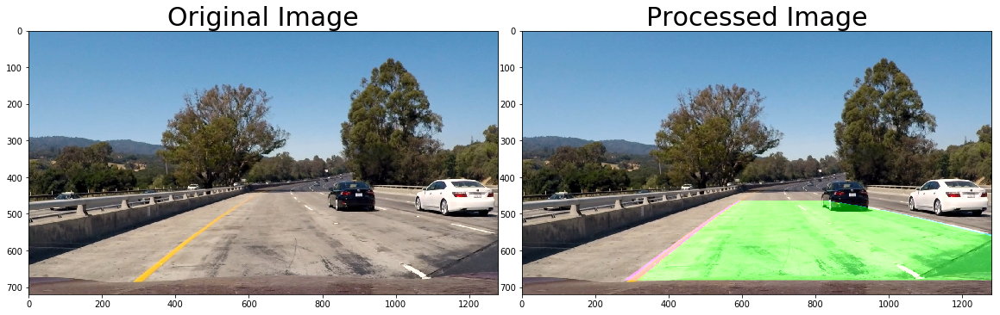

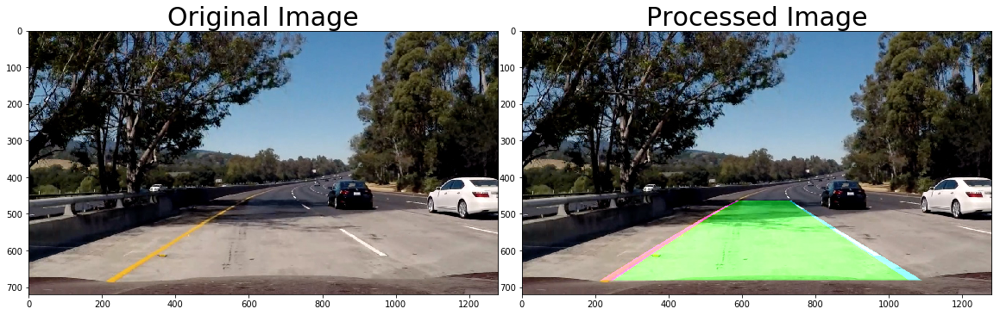

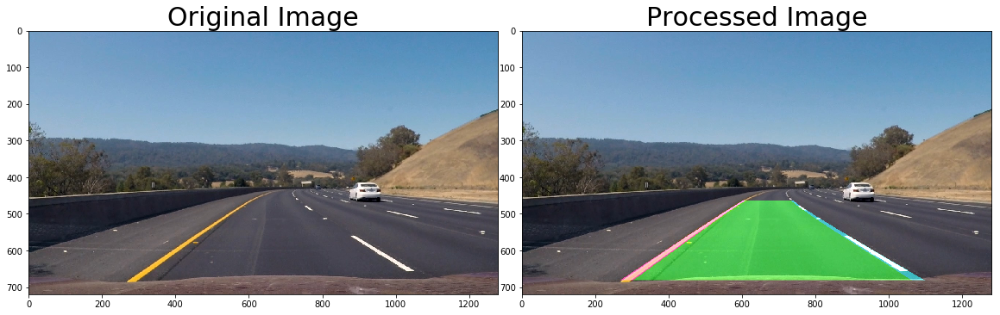

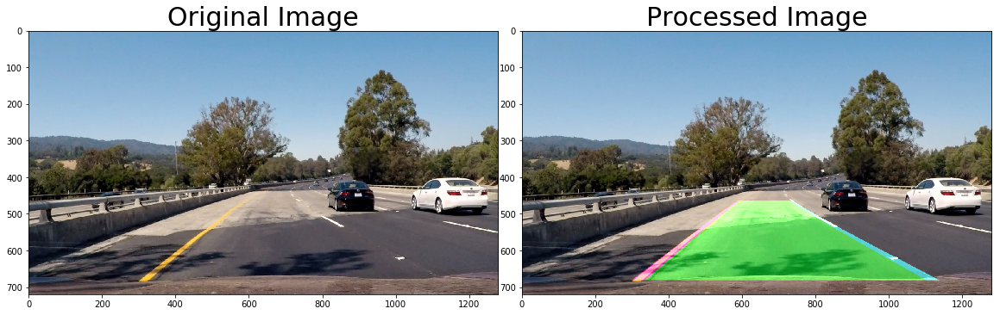

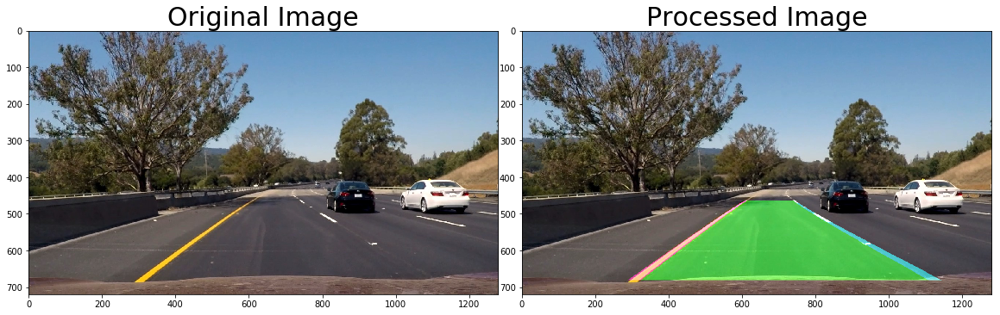

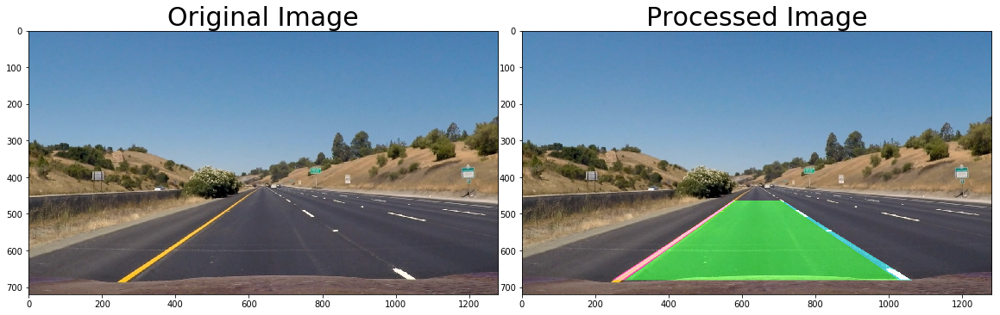

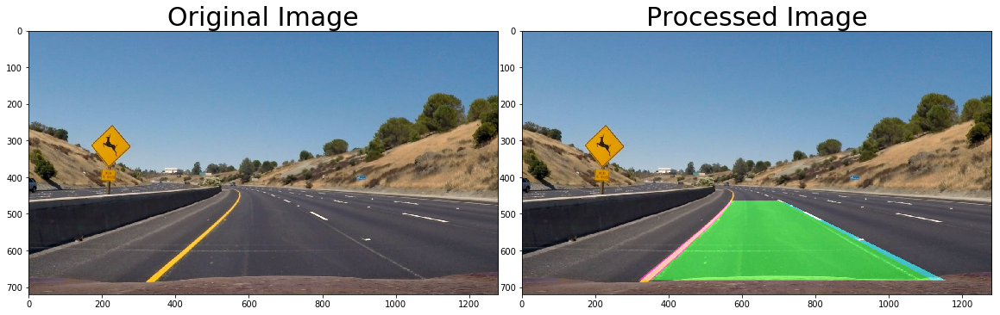

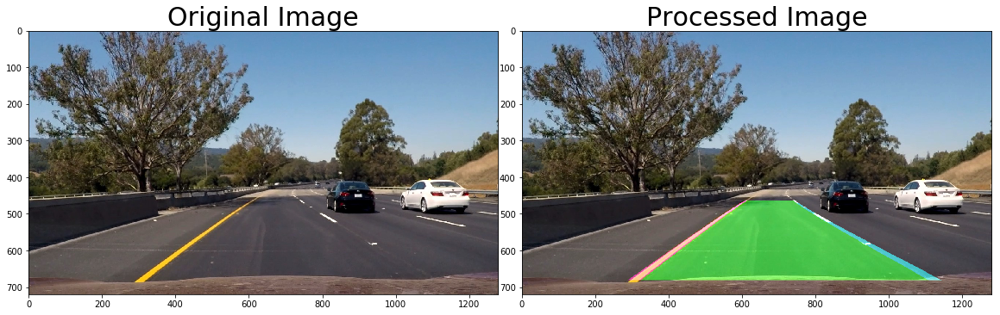

In [49]:
#test lane marking on original images
objpoints , imgpoints = calibration_point()

def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    hls_img = rgb_hls_converter(warped_img)
    lab_img = rgb_lab_converter(warped_img)
    combined_img = np.zeros_like(hls_img)
    combined_img[(lab_img == 1) | (hls_img == 1)] = 1
    #wy_img = rgb_to_white_yellow_converter(hls_img)
    #gray_img = grayscale_converter(wy_img)
    sobel_img = sobel_transformer(combined_img*(255))
    #keypoint_detection(whiten_img)
    #whiten_img = np.dstack((sobel_img,sobel_img,sobel_img))*255
    polyfit_img, left_fit, right_fit = sliding_window_polynomial_generator(sobel_img)
    poly_img, left_fit, right_fit = search_around_poly(sobel_img, left_fit, right_fit)
    curve_rad, center_dist, left_fitx, right_fitx = radius_central_distance_calculator(poly_img, left_fit, right_fit)
    lane_img = original_image_lane_marker(img, sobel_img, left_fit, right_fit, Minv)
    return lane_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)
    

## Write Radius of Curvature and Distance from Center on image

In [51]:
def image_writer(img, radius, center):
    new_img = np.copy(img)
    h = new_img.shape[0]
    font = cv2.FONT_HERSHEY_DUPLEX
    text = 'Curve radius: ' + '{:04.2f}'.format(radius) + 'm'
    cv2.putText(new_img, text, (40,70), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    direction = ''
    if center > 0:
        direction = 'right'
    elif center < 0:
        direction = 'left'
    abs_center = abs(center)
    text = '{:04.3f}'.format(abs_center) + 'm ' + direction + ' of center'
    cv2.putText(new_img, text, (40,120), font, 1.5, (200,255,155), 2, cv2.LINE_AA)
    return new_img

### Test runs

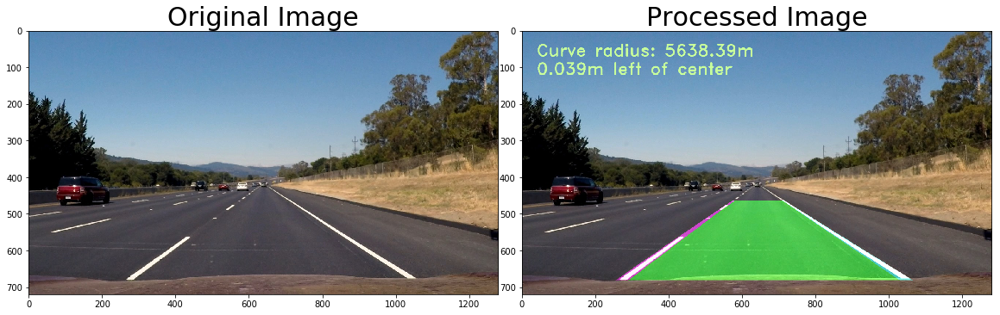

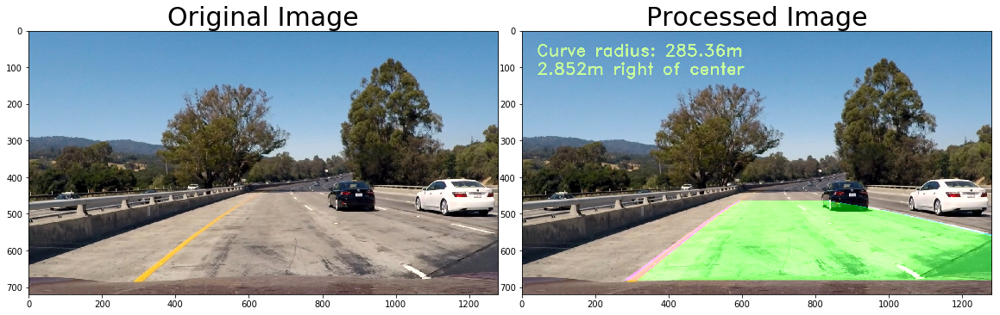

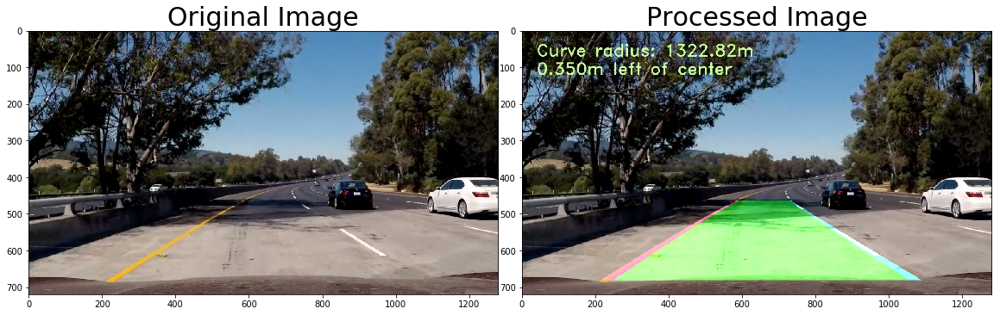

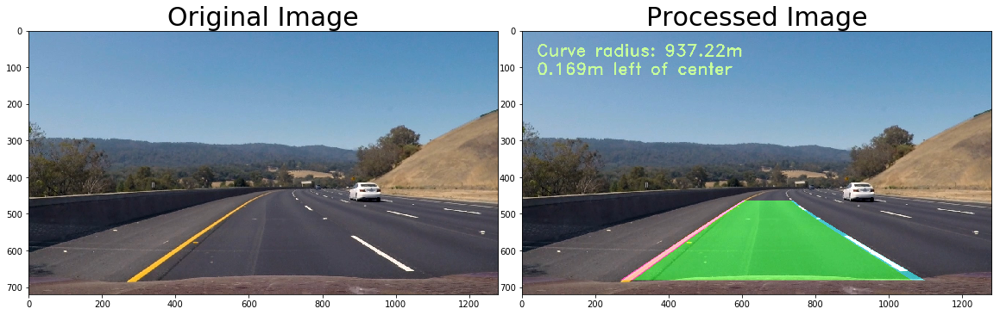

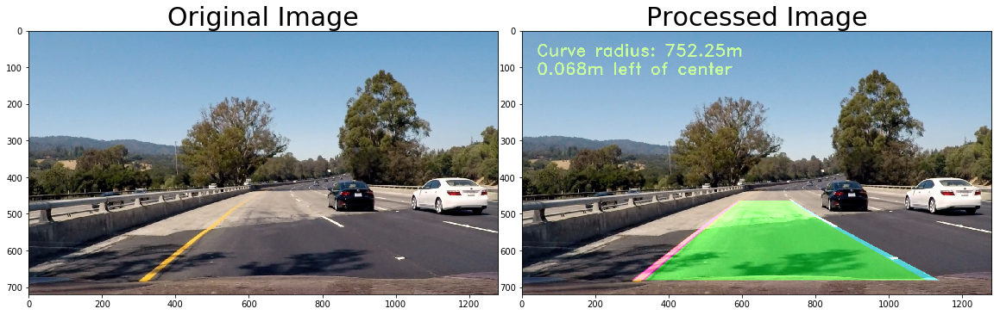

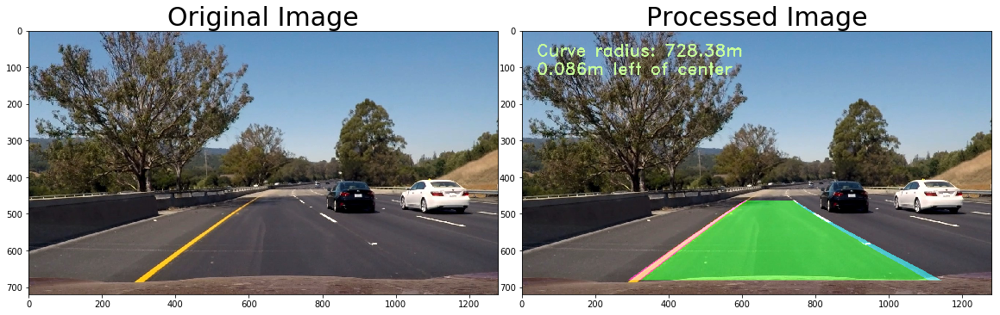

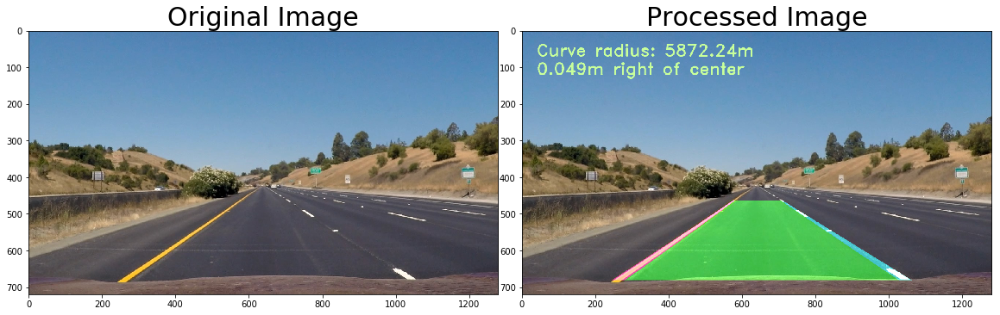

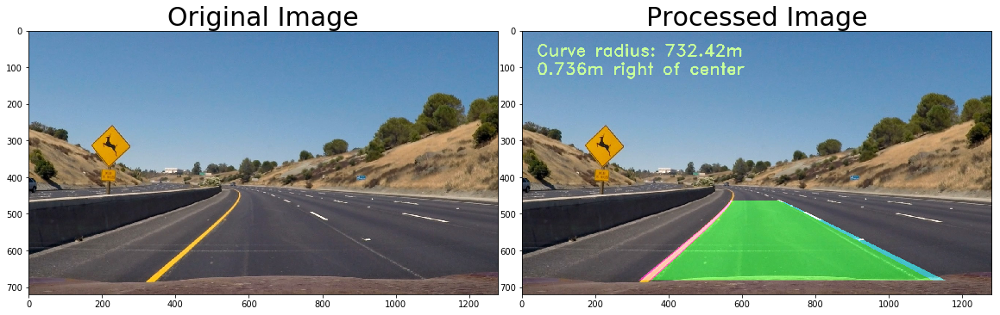

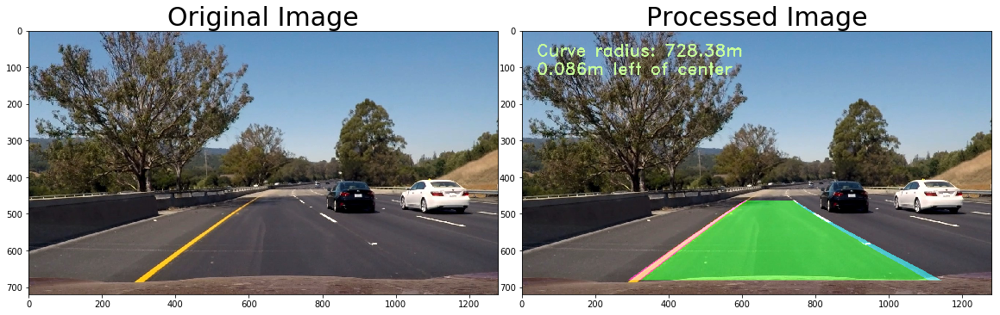

In [52]:
#final image processing test on test_images set
objpoints , imgpoints = calibration_point()

def lane_detector(img,objpoints,imgpoints):
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    hls_img = rgb_hls_converter(warped_img)
    lab_img = rgb_lab_converter(warped_img)
    combined_img = np.zeros_like(hls_img)
    combined_img[(lab_img == 1) | (hls_img == 1)] = 1
    #wy_img = rgb_to_white_yellow_converter(hls_img)
    #gray_img = grayscale_converter(wy_img)
    sobel_img = sobel_transformer(combined_img*(255))
    #keypoint_detection(whiten_img)
    #whiten_img = np.dstack((sobel_img,sobel_img,sobel_img))*255
    polyfit_img, left_fit, right_fit = sliding_window_polynomial_generator(sobel_img)
    poly_img, left_fit, right_fit = search_around_poly(sobel_img, left_fit, right_fit)
    curve_rad, center_dist, left_fitx, right_fitx = radius_central_distance_calculator(poly_img, left_fit, right_fit)
    lane_img = original_image_lane_marker(img, sobel_img, left_fit, right_fit, Minv)
    final_img = image_writer(lane_img, curve_rad, center_dist)
    return final_img

"""Test Images"""
test_img_dir = 'test_images_/'
test_img_files = os.listdir(test_img_dir)
for i in range(len(test_img_files)):
    filename = test_img_files[i]
    filepath = os.path.join(test_img_dir, filename)
    # read in images and pass in the pipeline
    image = mpimg.imread(filepath)
    lane_image = lane_detector(image,objpoints, imgpoints)
    # Visualize undistortion
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    f.subplots_adjust(hspace = .2, wspace=.05)
    ax1.imshow(image)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(lane_image)
    ax2.set_title('Processed Image', fontsize=30)


## Pipeline design for video processing

### Preprocessing pipeline for making image color conversions and transforms

In [53]:
#image preprocessing pipeline for lane finding pipeline
def preprocessing_pipeline(img):
    
    #undistortion of image
    undistorted_img = undistort_image(objpoints, imgpoints, img)
    
    #keypoint detection to get hyperparameters for perspective transform
    #However! Hyperparameters give a good result. Using keypoints is kindof useless
    #keypoint_detection(undistorted_img)
    
    # warping perspective
    warped_img , M , Minv = perspective_transformer(undistorted_img)
    
    #rgb color channel to hls color channel conversion
    #hls_img = rgb_hls_converter(warped_img)
    
    # hls color channel masking with white yellow channels
    #wy_img = rgb_to_white_yellow_converter(hls_img)
    
    #grayscale image conversion
    #gray_img = grayscale_converter(wy_img)
    
    #hls - l channel threshold masking
    hls_img = rgb_hls_converter(warped_img)
    
    #lab - b channel threshold masking
    lab_img = rgb_lab_converter(warped_img)
    
    #combination of both 
    combined = np.zeros_like(hls_img)
    combined[(lab_img == 1) | (hls_img == 1)] = 1
    
    #wy_img = rgb_to_white_yellow_converter(hls_img)
    #gray_img = grayscale_converter(wy_img)
    
    #sobel tranform of grayscale image
    #sobel_img = sobel_transformer(gray_img)
    sobel_img = sobel_transformer(combined*(255))
    
    #whiten_img = np.dstack((sobel_img,sobel_img,sobel_img))*255
    
    return sobel_img , Minv
    

### Lane Data storing class

In [65]:
# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = [] 
        #average x values of the fitted line over the last n iterations
        self.bestx = None
        #polynomial coefficients of the last n fits of the line
        self.recent_fit = []
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = []  
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 

        
    def add_fit_coeff(self, fit):
        if fit is not None and fit is not [0,0,450] and fit is not [0,0,830]:
            if self.best_fit is not None:
                self.diffs = np.absolute(fit - self.best_fit)
            if self.diffs[0] > 0.01 or self.diffs[1] > 1 or self.diffs[2] > 100 :
                self.detected = False
                if len(self.recent_fit) > 0:
                    self.current_fit = self.recent_fit[len(self.recent_fit)-1]
                else:
                    self.current_fit = fit
            else:
                self.detected = True
                self.current_fit = fit
                if len(self.recent_fit) != 0:
                    if len(self.recent_fit) > 5:
                        self.recent_fit = np.append(self.recent_fit,[fit], axis =0)
                        self.recent_fit = self.recent_fit[len(self.recent_fit)-5:]
                    else:
                        self.recent_fit = np.append(self.recent_fit,[fit], axis =0)
                    self.best_fit = np.average(self.recent_fit, axis=0)
                else:
                    self.recent_fit = [fit]
        
        else:
            self.detected = False
            if len(self.recent_fit) > 0:
                # throw out oldest fit
                self.recent_fit = self.recent_fit[1:len(self.recent_fit)]
            if len(self.recent_fit) > 0:
                # if there are still any fits in the queue, best_fit is their average
                self.current_fit = np.average(self.recent_fit, axis=0)
                self.best_fit = np.average(self.recent_fit, axis=0)
            elif self.best_fit is not None:
                self.current_fit = self.best_fit
            else:
                self.current_fit = None

        
    def add_xvalues(self, values):
        if len(self.recent_xfitted) != 0:
            if len(self.recent_xfitted)>5:
                self.recent_xfitted = np.hstack([self.recent_xfitted, values])
                self.recent_xfitted = self.current_fit[len(self.current_fit)-5:]
            else:
                self.recent_xfitted = np.hstack([self.recent_xfitted, values])
            self.bestx = np.average(self.recent_xfitted, axis=0)
            
        else:
            self.recent_xfitted = values
        
    

### Faster lane finding functions

In [55]:
def sliding_window_polynomial(img):
    copy_img = np.copy(img)
    # Take a histogram of the bottom half of the image
    histogram = np.sum(img[img.shape[0]//2:,:], axis=0)
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    #midpoint = np.int(img.shape)
    midpoint = np.int(histogram.shape[0]//2)
    quarterpoint = np.int(midpoint//2)
    #plt.plot(histogram)
    
    #setting base values
    if np.argmax(histogram[:midpoint]) > 100:
        leftx_base = np.argmax(histogram[:midpoint])
        #margin = 100
    else:
        leftx_base = 450
        #margin = 200
    if np.argmax(histogram[midpoint:]) > 100:
        rightx_base = np.argmax(histogram[midpoint:]) + midpoint
        #margin = 100
    else:
        rightx_base = 830
        #margin =200
    
    # HYPERPARAMETERS
    # Choose the number of sliding windows
    nwindows = 10
    # Set the width of the windows +/- margin
    margin = 80
    # Set minimum number of pixels found to recenter window
    minpix = 40

    # Set height of windows - based on nwindows above and image shape
    window_height = np.int(img.shape[0]//nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated later for each window in nwindows
    leftx_current = leftx_base
    rightx_current = rightx_base

    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = img.shape[0] - (window+1)*window_height
        win_y_high = img.shape[0] - window*window_height
        ###Find the four below boundaries of the window ###
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        
        #good left and right index
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xleft_low) &  (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & 
        (nonzerox >= win_xright_low) &  (nonzerox < win_xright_high)).nonzero()[0]
        
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        
        ###If you found > minpix pixels, recenter next window ###
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))

        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))



    # Concatenate the arrays of indices (previously was a list of lists of pixels)
    try:
        left_lane_inds = np.concatenate(left_lane_inds)
        right_lane_inds = np.concatenate(right_lane_inds)
    except ValueError:
        # Avoids an error if the above is not implemented fully
        pass

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    
    #Fit a second order polynomial to each using `np.polyfit`
    if len(leftx)!=0  and len(lefty) !=0:
        left_fit = np.polyfit(lefty, leftx, 2)
    else:
        left_fit = [0,0,450]
    if len(rightx)!=0 and len(righty)!=0:
        right_fit = np.polyfit(righty, rightx, 2)
    else:
        right_fit = [0,0,830]
    
    
    return left_fit, right_fit


In [56]:
def search_around_polynomial(binary_img, left_fit, right_fit):
    # HYPERPARAMETER
    # Choose the width of the margin around the previous polynomial to search
    margin = 100

    # Grab activated pixels
    nonzero = binary_img.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    
    ### Set the area of search based on activated x-values ###
    ### within the +/- margin of our polynomial function ###
    ### consider the window areas for the similarly named variables ###
    ### but change the windows to our new search area ###
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + 
                    left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + 
                    left_fit[1]*nonzeroy + left_fit[2] + margin)))
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + 
                    right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + 
                    right_fit[1]*nonzeroy + right_fit[2] + margin)))
    
    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]

    # Fit new polynomials
    ### Fit a second order polynomial to each with np.polyfit() ###
    if len(lefty)!=0 and len(leftx)!=0:
        left_fit = np.polyfit(lefty, leftx, 2)
    else:
        left_fit=[0,0,450]
    if len(righty)!=0 and len(rightx)!=0:
        right_fit = np.polyfit(righty, rightx, 2)
    else:
        right_fit = [0,0,830]
    
    
    return left_fit, right_fit

## Final pipeline

In [57]:
objpoints , imgpoints = calibration_point()

#final pipeline for lane finding
def pipeline(img):
    original_img = np.copy(img)
    binary_img, Minv = preprocessing_pipeline(img)
    
    #if lanes were detected in previous frame, then use search_around_poly else, use sliding_window_polyfit_generator
    if not left.detected or not right.detected :
        left_fit, right_fit = sliding_window_polynomial(binary_img)
    else:
        left_fit, right_fit = search_around_polynomial(binary_img, left.current_fit, right.current_fit)
    
    # invalidate both fits if the difference in their x-intercepts isn't around 350 px (+/- 100 px)
    if left_fit is not None and right_fit is not None:
        # calculate x-intercept (bottom of image, x=image_height) for fits
        h = img.shape[0]
        left_fit_x = left_fit[0]*h**2 + left_fit[1]*h + left_fit[2]
        right_fit_x = right_fit[0]*h**2 + right_fit[1]*h + right_fit[2]
        bottom_x_diff = abs(right_fit_x-left_fit_x)
        if abs(350 - bottom_x_diff) > 100:
            left_fit = None
            right_fit = None
            
            
    left.add_fit_coeff(left_fit)
    right.add_fit_coeff(right_fit)
    
    # draw the current fit if it exists
    
    img_out1 = original_image_lane_marker(original_img, binary_img, left.current_fit, right.current_fit, Minv)
    radius, center, left_fitx, right_fitx = radius_central_distance_calculator(img, left.current_fit, right.current_fit)
    left.add_xvalues(left_fitx)
    right.add_xvalues(right_fitx)
    img_out = image_writer(img_out1, radius, center)
    #elif left.current_fit is None and right.current_fit is not None:
        #img_out1 = original_image_lane_marker(original_img, binary_img, left.best_fit, right.current_fit, Minv)
        #radius, center, left_fitx, right_fitx = radius_central_distance_calculator(img, left.best_fit, right.current_fit)
        #left.add_xvalues(left_fitx)
        #right.add_xvalues(right_fitx)
        #img_out = image_writer(img_out1, radius, center)
    #elif left.current_fit is not None and right.current_fit is None:
        #img_out1 = original_image_lane_marker(original_img, binary_img, left.current_fit, right.best_fit, Minv)
        #radius, center, left_fitx, right_fitx = radius_central_distance_calculator(img, left.current_fit, right.best_fit)
        #left.add_xvalues(left_fitx)
        #right.add_xvalues(right_fitx)
        #img_out = image_writer(img_out1, radius, center)
    #else:
        #img_out1 = original_image_lane_marker(original_img, binary_img, left.best_fit, right.best_fit, Minv)
        #radius, center, left_fitx, right_fitx = radius_central_distance_calculator(img, left.best_fit, right.best_fit)
        #left.add_xvalues(left_fitx)
        #right.add_xvalues(right_fitx)
        #img_out = image_writer(img_out1, radius, center)
    return img_out
    

## Project video processing

In [58]:
from moviepy.editor import VideoFileClip
from IPython.display import HTML

In [59]:
left = Line()
right = Line()
#my_clip.write_gif('test.gif', fps=12)#my_clip. 
video_output1 = 'project_video_output.mp4'
video_input1 = VideoFileClip('project_video.mp4')#.subclip(22,26)
processed_video = video_input1.fl_image(pipeline)
%time processed_video.write_videofile(video_output1, audio=False)

[MoviePy] >>>> Building video project_video_output.mp4
[MoviePy] Writing video project_video_output.mp4


100%|█████████▉| 1260/1261 [10:30<00:00,  2.04it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_output.mp4 

CPU times: user 8min 21s, sys: 3.29 s, total: 8min 25s
Wall time: 10min 33s


In [60]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output1))

In [61]:
left = Line()
right = Line()
#my_clip.write_gif('test.gif', fps=12)#my_clip. 

video_output2 = 'challenge_video_output.mp4'
video_input1 = VideoFileClip('challenge_video.mp4')#.subclip(22,26)
processed_video = video_input1.fl_image(pipeline)
%time processed_video.write_videofile(video_output2, audio=False)

[MoviePy] >>>> Building video challenge_video_output.mp4
[MoviePy] Writing video challenge_video_output.mp4


100%|██████████| 485/485 [03:59<00:00,  2.04it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: challenge_video_output.mp4 

CPU times: user 3min 12s, sys: 1.29 s, total: 3min 13s
Wall time: 4min 2s


In [62]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output2))

In [63]:
left = Line()
right = Line()
#my_clip.write_gif('test.gif', fps=12)#my_clip. 
video_output3 = 'harder_challenge_video_output.mp4'
video_input1 = VideoFileClip('harder_challenge_video.mp4')#.subclip(22,26)
processed_video = video_input1.fl_image(pipeline)
%time processed_video.write_videofile(video_output3, audio=False)

[MoviePy] >>>> Building video harder_challenge_video_output.mp4
[MoviePy] Writing video harder_challenge_video_output.mp4


100%|█████████▉| 1199/1200 [10:35<00:00,  1.47it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: harder_challenge_video_output.mp4 

CPU times: user 7min 54s, sys: 3.29 s, total: 7min 58s
Wall time: 10min 40s


In [64]:
HTML("""
<video width="960" height="540" controls>
  <source src="{0}">
</video>
""".format(video_output3))